In [ ]:
# from google.colab import drive
# drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
# !python -m pip install torchinfo

In [1]:
%run ./Utils.ipynb

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import torchvision
import torchinfo
from torchvision import models
import torch.nn.init as init
import torch.optim as optim
import warnings
import torch.optim.lr_scheduler as lr_scheduler
warnings.filterwarnings("ignore")

In [3]:
batch_size = 64
val_batch_size = 5
device = 'cuda:0'

In [54]:
train_dataset = FinalDataset(X_path="../data/L_256.pt", y_path="../data/AB_256.pt")
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=1)

In [21]:
val_dataset = FinalDataset(X_path="../data/val_L_256.pt", y_path="../data/val_AB_256.pt")
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=val_batch_size, num_workers=1)

In [4]:
class AttentionBlock(nn.Module):
    def __init__(self, upConv_out, en_out):
        super().__init__()

        self.w_K = nn.Sequential(nn.Conv2d(upConv_out, upConv_out, kernel_size=1), nn.BatchNorm2d(upConv_out))
        self.w_Q = nn.Sequential(nn.Conv2d(en_out, en_out, kernel_size=1), nn.BatchNorm2d(en_out))
        self.AtnnHead = nn.Sequential(nn.Conv2d(upConv_out, 1, kernel_size=1), nn.BatchNorm2d(1), nn.Sigmoid())
        self.relu = nn.ReLU(inplace=True)

    def forward(self, upConv, encoder):
        K = self.w_K(upConv)
        Q = self.w_Q(encoder)
        D = self.relu(K+Q)
        D = self.AtnnHead(D)

        return upConv * D

In [5]:
class UNet(nn.Module):
  def __init__(self, enc_layer):
    super(UNet, self).__init__()
    self.conv = enc_layer[0]
    self.pool = nn.MaxPool2d(2, 2)                                               # Will halve the dim and twice the depth
    self.enAct = nn.ReLU()
    self.act = nn.LeakyReLU(0.3)
    self.out = nn.Tanh()
    self.en_layer_1 = enc_layer[1]
    self.en_layer_2 = enc_layer[2]
    self.en_layer_3 = enc_layer[3]
    self.en_layer_4 = enc_layer[4]
    self.en_layer_5 = enc_layer[5]
    self.de_upConv_1 = nn.ConvTranspose2d(512, 256, 2, 2)                        # Will upsample the output of last layer
    self.de_batchnorm_1 = nn.BatchNorm2d(256)
    self.de_attn_head_1 = AttentionBlock(256, 256)
    self.de_conv_1_2 = nn.Conv2d(256, 256, 3, padding=1)
    self.de_batchnorm_1_2 = nn.BatchNorm2d(256)
    self.de_upConv_2 = nn.ConvTranspose2d(256, 128, 2, 2)
    self.de_batchnorm_2 = nn.BatchNorm2d(128)
    self.de_attn_head_2 = AttentionBlock(128, 128)
    self.de_conv_2_2 = nn.Conv2d(128, 128, 3, padding=1)
    self.de_batchnorm_2_2 = nn.BatchNorm2d(128)
    self.de_upConv_3 = nn.ConvTranspose2d(128, 64, 2, 2)
    self.de_batchnorm_3 = nn.BatchNorm2d(64)
    self.de_attn_head_3 = AttentionBlock(64, 64)
    self.de_conv_3_2 = nn.Conv2d(64, 64, 3, padding=1)
    self.de_batchnorm_3_2 = nn.BatchNorm2d(64)
    self.de_upConv_4 = nn.ConvTranspose2d(64, 32, 2, 2)
    self.de_batchnorm_4 = nn.BatchNorm2d(32)
    self.de_attn_head_4 = AttentionBlock(32, 32)
    self.de_conv_4_2 = nn.Conv2d(32, 32, 3, padding=1)
    self.de_batchnorm_4_2 = nn.BatchNorm2d(32)

    self.output_conv = nn.Conv2d(32, 2, 3, padding=1)
    self.out_batchnorm = nn.LayerNorm([2, 256, 256])

  def forward(self, x):
    x = self.conv(x)
    en_1 = self.en_layer_1(x)                                                    # Resnet block will output same dim images with double depth each turn; will pool after each resnet layer for dim/2
    x = self.pool(en_1)
    en_2 = self.en_layer_2(x)                                                    # These outputs will be concated with decoder layer, for better result as suggested in the paper
    x = self.pool(en_2)
    en_3 = self.en_layer_3(x)
    x = self.pool(en_3)
    en_4 = self.en_layer_4(x)
    x = self.pool(en_4)
    en_5 = self.en_layer_5(x)
    up_1 = self.de_upConv_1(en_5)                                                # The kernel and strides are chosen such that dim of feature doubles but we halve the depth
    up_1 = self.de_batchnorm_1(up_1)
    x = self.de_attn_head_1(up_1, en_4)                                          # Using attention instead of a decoder conv and concat
    x = self.act(self.de_conv_1_2(x))
    x = self.de_batchnorm_1_2(x)
    up_2 = self.de_upConv_2(x)
    up_2 = self.de_batchnorm_2(up_2)
    x = self.de_attn_head_2(up_2, en_3)
    x = self.act(self.de_conv_2_2(x))
    x = self.de_batchnorm_2_2(x)
    up_3 = self.de_upConv_3(en_3)
    up_3 = self.de_batchnorm_3(up_3)
    x = self.de_attn_head_3(up_3, en_2)
    x = self.act(self.de_conv_3_2(x))
    x = self.de_batchnorm_3_2(x)
    up_4 = self.de_upConv_4(x)
    up_4 = self.de_batchnorm_4(up_4)
    x = self.de_attn_head_4(up_4, en_1)
    x = self.act(self.de_conv_4_2(x))
    x = self.de_batchnorm_4_2(x)

    x = self.output_conv(x)
    x = self.out_batchnorm(x)

    return self.out(x)

In [6]:
class Discriminator(nn.Module):
  def __init__(self, enc_layer):
    super(Discriminator, self).__init__()
    self.imageNorm = nn.LayerNorm([3, 256, 256])
    self.conv = nn.Sequential(nn.Conv2d(3, 16, 3, padding=1), nn.ReLU(), nn.BatchNorm2d(16))
    self.en_layer_1 = enc_layer[1]
    self.en_layer_2 = enc_layer[2]
    self.en_layer_3 = enc_layer[3]
    self.en_layer_4 = enc_layer[4]
    self.en_layer_5 = enc_layer[6]

    self.pool = nn.MaxPool2d(2, 2)

    self.out_conv_0 = nn.Conv2d(256, 128, 3, padding= 1)
    self.out_batchnorm_0 = nn.BatchNorm2d(128)
    self.out_conv_1 = nn.Conv2d(128, 64, 3, padding= 1)
    self.out_batchnorm_1 = nn.BatchNorm2d(64)
    self.out_conv_2 = nn.Conv2d(64, 1, 3, padding= 1)
    self.out_batchnorm_2 = nn.BatchNorm2d(1)

    self.act = nn.LeakyReLU(0.3)

  def forward(self, x):
    x = self.imageNorm(x)
    x = self.conv(x)
    x = self.en_layer_1(x)
    x = self.pool(x)
    x = self.en_layer_2(x)
    x = self.pool(x)
    x = self.en_layer_3(x)
    x = self.en_layer_4(x)
    x = self.en_layer_5(x)
    x = self.act(self.out_conv_0(x))
    x= self.out_batchnorm_0(x)
    x = self.act(self.out_conv_1(x))
    x= self.out_batchnorm_1(x)

    return self.out_conv_2(x)

In [7]:
class ColorisationModel(nn.Module):
  def __init__(self, block, lr_unet= 2e-4, lr_discr= 2e-6):
    super(ColorisationModel, self).__init__()
    self.encoder = []
    self.encoder.append(nn.Sequential(nn.Conv2d(1, 16, 3, padding=1), nn.ReLU(), nn.BatchNorm2d(16)))
    self.encoder.append(residual_layer(block, 1, 16, 0.1))
    self.encoder.append(residual_layer(block, 1, 32, 0.1))
    self.encoder.append(residual_layer(block, 1, 64, 0.1))
    self.encoder.append(residual_layer(block, 1, 128, 0.1))
    self.encoder.append(residual_layer(block, 1, 256, 0.1))
    self.encoder.append(nn.Sequential(nn.Conv2d(256, 256, 3, padding=1), nn.ReLU(), nn.BatchNorm2d(256)))

    self.unet = UNet(self.encoder)                                               # Unet and Discriminator will share same weights
    self.discriminator = Discriminator(self.encoder)
    self.unet_optimiser = optimiser = optim.Adam(self.unet.parameters(), lr=lr_unet, betas=(0.5, 0.999))
    self.discriminator_optimiser = optim.SGD(self.discriminator.parameters(), lr=lr_discr, momentum=0.9)
    self.unet_scheduler = None
    self.discriminator_scheduler = None

  def forward(self, X, y):

    # First forward pass of unet
    pred_unet = self.unet(X)

    # Preparation for discriminator
    pred_image = torch.cat([X, pred_unet], dim= 1)
    true_image = torch.cat([X, y], dim= 1)

    # Discriminator forward pass
    pred_discr_T = self.discriminator(true_image)
    pred_discr_F = self.discriminator(pred_image)

    return (pred_unet, torch.squeeze(pred_discr_T), torch.squeeze(pred_discr_F))

In [19]:
def val_model(model, showImages):
  avg_disc_loss = 0
  avg_unet_loss = 0
  l1_lambda = 2.
  l1_loss = nn.L1Loss()
  bceLoss = nn.BCEWithLogitsLoss()
  batch_count = 0
  for (X, y) in val_loader:
    X = X.to(device)
    y = y.to(device)
    
    if(showImages):
        imshow(X, y)
        imshow(X, model.unet(X))
        batch_count = 1
        break;

    (pred_unet, pred_discr_T, pred_discr_F) = model.forward(X, y)


    # Calculating loss for each net
    pred_labels = torch.squeeze(torch.cat([pred_discr_T, pred_discr_F]))
    true_labels = torch.squeeze(torch.cat([torch.ones(pred_discr_T.shape), torch.zeros(pred_discr_F.shape)])).to(device)
    loss_gan_discr = bceLoss(pred_labels, true_labels)
    loss_gan_unet = bceLoss(torch.squeeze(pred_discr_F), torch.zeros(pred_discr_F.shape).to(device))
    loss_unet = loss_gan_unet + l1_lambda * l1_loss(pred_unet, y)

    avg_disc_loss += loss_gan_discr.item()
    avg_unet_loss += loss_unet.item()
      
    batch_count+= 1;

  return avg_disc_loss / batch_count, avg_unet_loss / batch_count

In [12]:
model = ColorisationModel(ResidualBlock)
# model.load_state_dict(torch.load("./GANResNetBackbone_AttnUNet/UNet_2070.pth"))
# disc_loss_list = torch.load('./GANResNetBackbone_AttnUNet/training_disc__loss.pt')
# unet_loss_list = torch.load('./GANResNetBackbone_AttnUNet/training_unet_loss.pt')
# val_disc_loss_list = torch.load('./GANResNetBackbone_AttnUNet/validation_disc_loss.pt')
# val_unet_loss_list = torch.load('./GANResNetBackbone_AttnUNet/validation_unet_loss.pt')
model.unet.to(device)
model.discriminator.to(device)
disc_loss_list = []
unet_loss_list = []
val_disc_loss_list = []
val_unet_loss_list = []

def train_model(num_epochs, model):
  bceLoss = nn.BCEWithLogitsLoss()
  l1_loss = nn.L1Loss()
  l1_lambda = 2.
  model.unet.train()
  model.discriminator.train()
  for epoch in range(num_epochs):
    epoch = epoch + 2070
    disc_epoch_loss = 0
    unet_epoch_loss = 0
    for batch_idx, (X, y) in enumerate(train_loader):
        X = X.to(device)
        y = y.to(device)

        # prediction from both models
        model.discriminator_optimiser.zero_grad()
        model.unet_optimiser.zero_grad()

        (pred_unet, pred_discr_T, pred_discr_F) = model.forward(X, y)


        # Calculating loss for each net
        pred_labels = torch.squeeze(torch.cat([pred_discr_T, pred_discr_F]))
        true_labels = torch.squeeze(torch.cat([torch.ones(pred_discr_T.shape, requires_grad= True), torch.zeros(pred_discr_F.shape, requires_grad= True)])).to(device)
        loss_gan_discr = bceLoss(pred_labels, true_labels)
        loss_gan_unet = bceLoss(torch.squeeze(pred_discr_F), torch.zeros(pred_discr_F.shape, requires_grad= True).to(device))
        loss_unet = loss_gan_unet + l1_lambda * l1_loss(pred_unet, y)

        disc_epoch_loss += loss_gan_discr.item()
        unet_epoch_loss += loss_unet.item()

        # Loss backwards and calling the optimiser
        loss_gan_discr.backward(retain_graph=True)
        loss_unet.backward()

        model.discriminator_optimiser.step()
        model.unet_optimiser.step()
        if(model.unet_scheduler != None):
          model.unet_scheduler.step()
        if(model.discriminator_scheduler != None):
          model.discriminator_scheduler.step()

        if batch_idx % 40 == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tGanLoss: {:.6f}\tUNetLoss: {:.6f}'.format(
              epoch, batch_idx * len(X), len(train_loader.dataset),
              100. * batch_idx / len(train_loader), loss_gan_discr.item(), loss_unet.item()))
    disc_loss_list.append(disc_epoch_loss)
    unet_loss_list.append(unet_epoch_loss)
    val_disc_loss, val_unet_loss = val_model(model, False)
    val_disc_loss_list.append(val_disc_loss)
    val_unet_loss_list.append(val_unet_loss)
    if epoch %10 == 0:
        print("Training Output: ")
        imshow(X, y)
        imshow(X, model.unet(X))
        print("validation Output: ")
        val_model(model, True)
    if epoch % 10 == 0:
        saveModel(model, './GANResNetBackbone_AttnUNet/UNet_' + str(epoch) + '.pth')
        torch.save(disc_loss_list, './GANResNetBackbone_AttnUNet/training_disc__loss.pt')
        torch.save(val_disc_loss_list, './GANResNetBackbone_AttnUNet/validation_disc_loss.pt')
        torch.save(unet_loss_list, './GANResNetBackbone_AttnUNet/training_unet_loss.pt')
        torch.save(val_unet_loss_list, './GANResNetBackbone_AttnUNet/validation_unet_loss.pt')

Train Epoch: 2070 [0/256 (0%)]	GanLoss: 0.352927	UNetLoss: 0.468986
Training Output: 


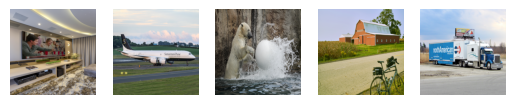

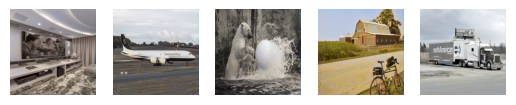

validation Output: 


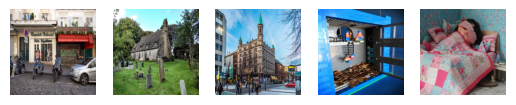

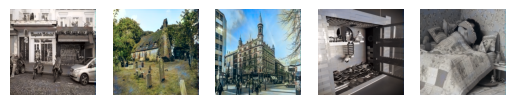


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2070.pth.
Train Epoch: 2071 [0/256 (0%)]	GanLoss: 0.352936	UNetLoss: 0.459883
Train Epoch: 2072 [0/256 (0%)]	GanLoss: 0.351851	UNetLoss: 0.463431
Train Epoch: 2073 [0/256 (0%)]	GanLoss: 0.352581	UNetLoss: 0.453845
Train Epoch: 2074 [0/256 (0%)]	GanLoss: 0.353107	UNetLoss: 0.463874
Train Epoch: 2075 [0/256 (0%)]	GanLoss: 0.352595	UNetLoss: 0.454403
Train Epoch: 2076 [0/256 (0%)]	GanLoss: 0.352261	UNetLoss: 0.462371
Train Epoch: 2077 [0/256 (0%)]	GanLoss: 0.353980	UNetLoss: 0.463458
Train Epoch: 2078 [0/256 (0%)]	GanLoss: 0.352387	UNetLoss: 0.459159
Train Epoch: 2079 [0/256 (0%)]	GanLoss: 0.352399	UNetLoss: 0.445549
Train Epoch: 2080 [0/256 (0%)]	GanLoss: 0.352579	UNetLoss: 0.465762
Training Output: 


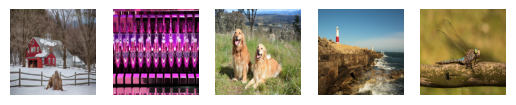

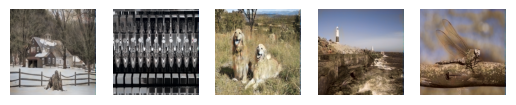

validation Output: 


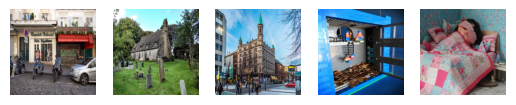

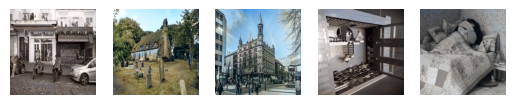


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2080.pth.
Train Epoch: 2081 [0/256 (0%)]	GanLoss: 0.352158	UNetLoss: 0.448397
Train Epoch: 2082 [0/256 (0%)]	GanLoss: 0.352027	UNetLoss: 0.445682
Train Epoch: 2083 [0/256 (0%)]	GanLoss: 0.352093	UNetLoss: 0.463176
Train Epoch: 2084 [0/256 (0%)]	GanLoss: 0.352247	UNetLoss: 0.453007
Train Epoch: 2085 [0/256 (0%)]	GanLoss: 0.352056	UNetLoss: 0.453622
Train Epoch: 2086 [0/256 (0%)]	GanLoss: 0.351801	UNetLoss: 0.459530
Train Epoch: 2087 [0/256 (0%)]	GanLoss: 0.351564	UNetLoss: 0.462689
Train Epoch: 2088 [0/256 (0%)]	GanLoss: 0.352332	UNetLoss: 0.459814
Train Epoch: 2089 [0/256 (0%)]	GanLoss: 0.351949	UNetLoss: 0.457095
Train Epoch: 2090 [0/256 (0%)]	GanLoss: 0.352323	UNetLoss: 0.450717
Training Output: 


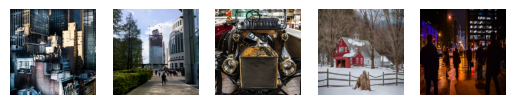

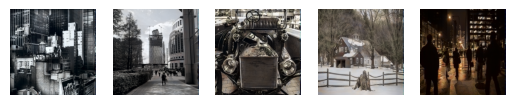

validation Output: 


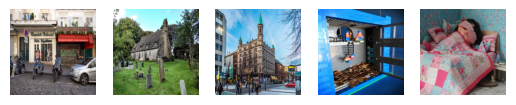

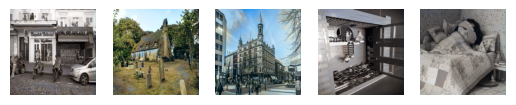


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2090.pth.
Train Epoch: 2091 [0/256 (0%)]	GanLoss: 0.352181	UNetLoss: 0.464244
Train Epoch: 2092 [0/256 (0%)]	GanLoss: 0.351727	UNetLoss: 0.459546
Train Epoch: 2093 [0/256 (0%)]	GanLoss: 0.352335	UNetLoss: 0.461929
Train Epoch: 2094 [0/256 (0%)]	GanLoss: 0.351494	UNetLoss: 0.452428
Train Epoch: 2095 [0/256 (0%)]	GanLoss: 0.351212	UNetLoss: 0.460805
Train Epoch: 2096 [0/256 (0%)]	GanLoss: 0.351628	UNetLoss: 0.445421
Train Epoch: 2097 [0/256 (0%)]	GanLoss: 0.351385	UNetLoss: 0.450737
Train Epoch: 2098 [0/256 (0%)]	GanLoss: 0.351574	UNetLoss: 0.461148
Train Epoch: 2099 [0/256 (0%)]	GanLoss: 0.351695	UNetLoss: 0.459760
Train Epoch: 2100 [0/256 (0%)]	GanLoss: 0.351532	UNetLoss: 0.452530
Training Output: 


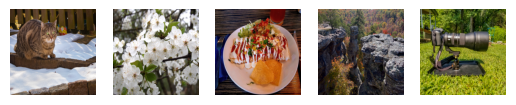

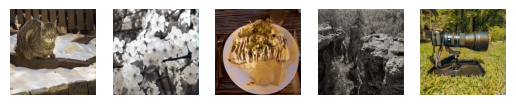

validation Output: 


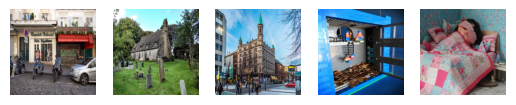

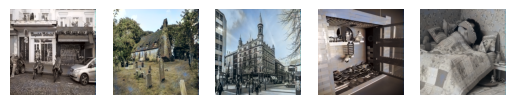


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2100.pth.
Train Epoch: 2101 [0/256 (0%)]	GanLoss: 0.351493	UNetLoss: 0.453102
Train Epoch: 2102 [0/256 (0%)]	GanLoss: 0.351531	UNetLoss: 0.453132
Train Epoch: 2103 [0/256 (0%)]	GanLoss: 0.351459	UNetLoss: 0.470823
Train Epoch: 2104 [0/256 (0%)]	GanLoss: 0.351132	UNetLoss: 0.457077
Train Epoch: 2105 [0/256 (0%)]	GanLoss: 0.351905	UNetLoss: 0.447684
Train Epoch: 2106 [0/256 (0%)]	GanLoss: 0.351922	UNetLoss: 0.471485
Train Epoch: 2107 [0/256 (0%)]	GanLoss: 0.352224	UNetLoss: 0.470255
Train Epoch: 2108 [0/256 (0%)]	GanLoss: 0.351024	UNetLoss: 0.459089
Train Epoch: 2109 [0/256 (0%)]	GanLoss: 0.350626	UNetLoss: 0.462816
Train Epoch: 2110 [0/256 (0%)]	GanLoss: 0.351537	UNetLoss: 0.446867
Training Output: 


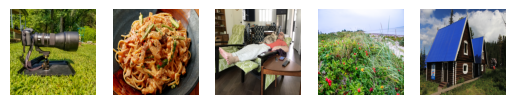

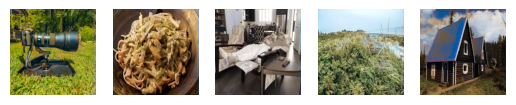

validation Output: 


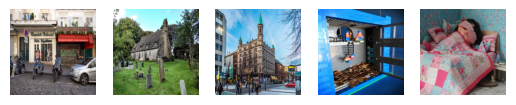

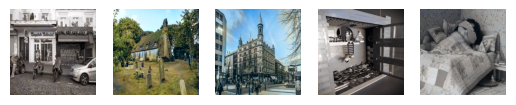


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2110.pth.
Train Epoch: 2111 [0/256 (0%)]	GanLoss: 0.351810	UNetLoss: 0.445550
Train Epoch: 2112 [0/256 (0%)]	GanLoss: 0.350917	UNetLoss: 0.456230
Train Epoch: 2113 [0/256 (0%)]	GanLoss: 0.350341	UNetLoss: 0.447797
Train Epoch: 2114 [0/256 (0%)]	GanLoss: 0.350362	UNetLoss: 0.449059
Train Epoch: 2115 [0/256 (0%)]	GanLoss: 0.350679	UNetLoss: 0.456265
Train Epoch: 2116 [0/256 (0%)]	GanLoss: 0.350689	UNetLoss: 0.455475
Train Epoch: 2117 [0/256 (0%)]	GanLoss: 0.350393	UNetLoss: 0.461213
Train Epoch: 2118 [0/256 (0%)]	GanLoss: 0.350753	UNetLoss: 0.457960
Train Epoch: 2119 [0/256 (0%)]	GanLoss: 0.350885	UNetLoss: 0.459342
Train Epoch: 2120 [0/256 (0%)]	GanLoss: 0.350395	UNetLoss: 0.458102
Training Output: 


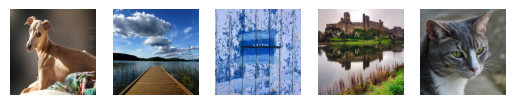

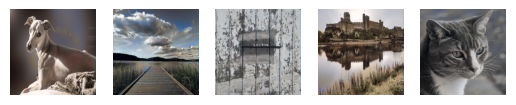

validation Output: 


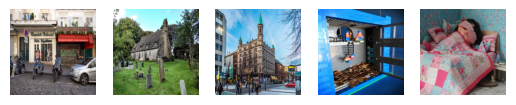

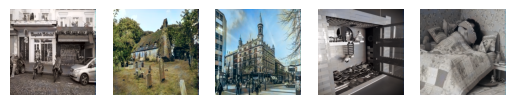


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2120.pth.
Train Epoch: 2121 [0/256 (0%)]	GanLoss: 0.350392	UNetLoss: 0.449686
Train Epoch: 2122 [0/256 (0%)]	GanLoss: 0.350472	UNetLoss: 0.466449
Train Epoch: 2123 [0/256 (0%)]	GanLoss: 0.350162	UNetLoss: 0.456150
Train Epoch: 2124 [0/256 (0%)]	GanLoss: 0.350911	UNetLoss: 0.476863
Train Epoch: 2125 [0/256 (0%)]	GanLoss: 0.349863	UNetLoss: 0.459986
Train Epoch: 2126 [0/256 (0%)]	GanLoss: 0.350119	UNetLoss: 0.461508
Train Epoch: 2127 [0/256 (0%)]	GanLoss: 0.350782	UNetLoss: 0.450321
Train Epoch: 2128 [0/256 (0%)]	GanLoss: 0.349889	UNetLoss: 0.458188
Train Epoch: 2129 [0/256 (0%)]	GanLoss: 0.350182	UNetLoss: 0.459844
Train Epoch: 2130 [0/256 (0%)]	GanLoss: 0.349561	UNetLoss: 0.450733
Training Output: 


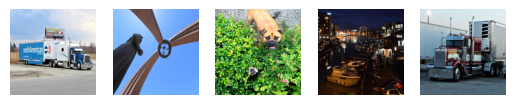

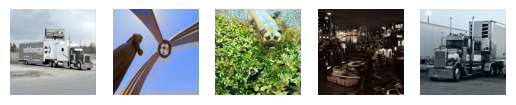

validation Output: 


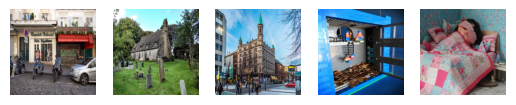

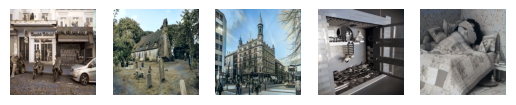


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2130.pth.
Train Epoch: 2131 [0/256 (0%)]	GanLoss: 0.350033	UNetLoss: 0.465677
Train Epoch: 2132 [0/256 (0%)]	GanLoss: 0.349929	UNetLoss: 0.465278
Train Epoch: 2133 [0/256 (0%)]	GanLoss: 0.350301	UNetLoss: 0.471032
Train Epoch: 2134 [0/256 (0%)]	GanLoss: 0.349612	UNetLoss: 0.457231
Train Epoch: 2135 [0/256 (0%)]	GanLoss: 0.349307	UNetLoss: 0.454077
Train Epoch: 2136 [0/256 (0%)]	GanLoss: 0.349625	UNetLoss: 0.468615
Train Epoch: 2137 [0/256 (0%)]	GanLoss: 0.350066	UNetLoss: 0.452447
Train Epoch: 2138 [0/256 (0%)]	GanLoss: 0.349369	UNetLoss: 0.456037
Train Epoch: 2139 [0/256 (0%)]	GanLoss: 0.349742	UNetLoss: 0.444042
Train Epoch: 2140 [0/256 (0%)]	GanLoss: 0.349627	UNetLoss: 0.446236
Training Output: 


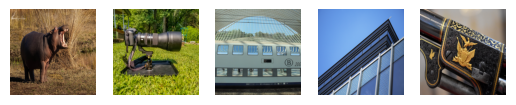

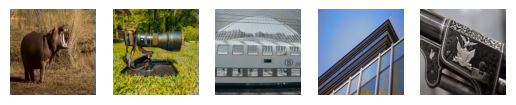

validation Output: 


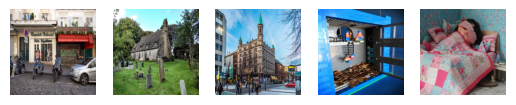

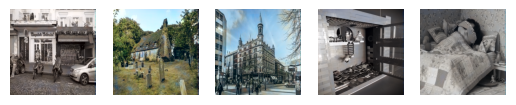


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2140.pth.
Train Epoch: 2141 [0/256 (0%)]	GanLoss: 0.349941	UNetLoss: 0.457527
Train Epoch: 2142 [0/256 (0%)]	GanLoss: 0.349934	UNetLoss: 0.443950
Train Epoch: 2143 [0/256 (0%)]	GanLoss: 0.349329	UNetLoss: 0.445846
Train Epoch: 2144 [0/256 (0%)]	GanLoss: 0.350084	UNetLoss: 0.459853
Train Epoch: 2145 [0/256 (0%)]	GanLoss: 0.349624	UNetLoss: 0.472789
Train Epoch: 2146 [0/256 (0%)]	GanLoss: 0.349040	UNetLoss: 0.446227
Train Epoch: 2147 [0/256 (0%)]	GanLoss: 0.349343	UNetLoss: 0.459034
Train Epoch: 2148 [0/256 (0%)]	GanLoss: 0.348913	UNetLoss: 0.441203
Train Epoch: 2149 [0/256 (0%)]	GanLoss: 0.349033	UNetLoss: 0.449517
Train Epoch: 2150 [0/256 (0%)]	GanLoss: 0.349491	UNetLoss: 0.461976
Training Output: 


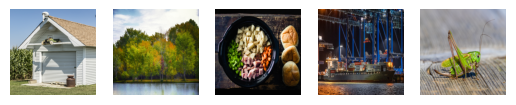

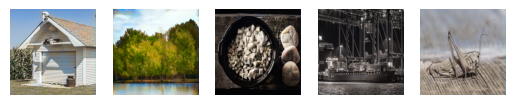

validation Output: 


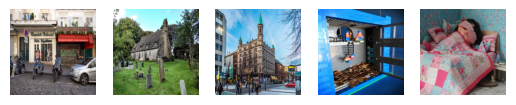

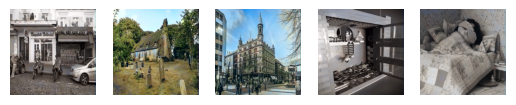


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2150.pth.
Train Epoch: 2151 [0/256 (0%)]	GanLoss: 0.348827	UNetLoss: 0.441701
Train Epoch: 2152 [0/256 (0%)]	GanLoss: 0.349567	UNetLoss: 0.448726
Train Epoch: 2153 [0/256 (0%)]	GanLoss: 0.349321	UNetLoss: 0.458386
Train Epoch: 2154 [0/256 (0%)]	GanLoss: 0.348737	UNetLoss: 0.451210
Train Epoch: 2155 [0/256 (0%)]	GanLoss: 0.348344	UNetLoss: 0.457167
Train Epoch: 2156 [0/256 (0%)]	GanLoss: 0.348538	UNetLoss: 0.454189
Train Epoch: 2157 [0/256 (0%)]	GanLoss: 0.349092	UNetLoss: 0.457998
Train Epoch: 2158 [0/256 (0%)]	GanLoss: 0.348461	UNetLoss: 0.448628
Train Epoch: 2159 [0/256 (0%)]	GanLoss: 0.349605	UNetLoss: 0.441788
Train Epoch: 2160 [0/256 (0%)]	GanLoss: 0.348409	UNetLoss: 0.454690
Training Output: 


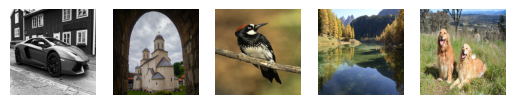

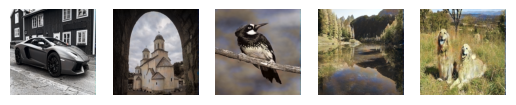

validation Output: 


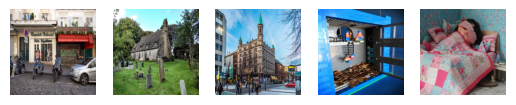

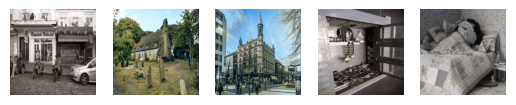


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2160.pth.
Train Epoch: 2161 [0/256 (0%)]	GanLoss: 0.348253	UNetLoss: 0.447556
Train Epoch: 2162 [0/256 (0%)]	GanLoss: 0.348971	UNetLoss: 0.434498
Train Epoch: 2163 [0/256 (0%)]	GanLoss: 0.348696	UNetLoss: 0.452320
Train Epoch: 2164 [0/256 (0%)]	GanLoss: 0.348419	UNetLoss: 0.457052
Train Epoch: 2165 [0/256 (0%)]	GanLoss: 0.349177	UNetLoss: 0.449349
Train Epoch: 2166 [0/256 (0%)]	GanLoss: 0.348047	UNetLoss: 0.446030
Train Epoch: 2167 [0/256 (0%)]	GanLoss: 0.348227	UNetLoss: 0.465073
Train Epoch: 2168 [0/256 (0%)]	GanLoss: 0.348870	UNetLoss: 0.444201
Train Epoch: 2169 [0/256 (0%)]	GanLoss: 0.348093	UNetLoss: 0.449170
Train Epoch: 2170 [0/256 (0%)]	GanLoss: 0.347816	UNetLoss: 0.452726
Training Output: 


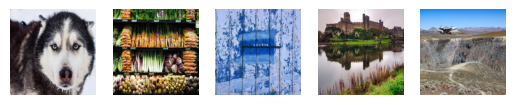

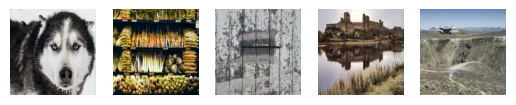

validation Output: 


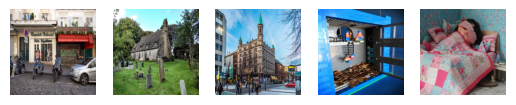

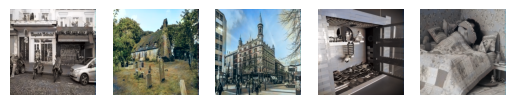


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2170.pth.
Train Epoch: 2171 [0/256 (0%)]	GanLoss: 0.348067	UNetLoss: 0.472082
Train Epoch: 2172 [0/256 (0%)]	GanLoss: 0.348241	UNetLoss: 0.458267
Train Epoch: 2173 [0/256 (0%)]	GanLoss: 0.348172	UNetLoss: 0.440474
Train Epoch: 2174 [0/256 (0%)]	GanLoss: 0.348400	UNetLoss: 0.446264
Train Epoch: 2175 [0/256 (0%)]	GanLoss: 0.347519	UNetLoss: 0.464621
Train Epoch: 2176 [0/256 (0%)]	GanLoss: 0.348434	UNetLoss: 0.456709
Train Epoch: 2177 [0/256 (0%)]	GanLoss: 0.348261	UNetLoss: 0.447564
Train Epoch: 2178 [0/256 (0%)]	GanLoss: 0.347921	UNetLoss: 0.442761
Train Epoch: 2179 [0/256 (0%)]	GanLoss: 0.347364	UNetLoss: 0.460117
Train Epoch: 2180 [0/256 (0%)]	GanLoss: 0.347587	UNetLoss: 0.454863
Training Output: 


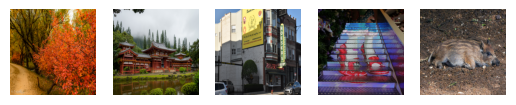

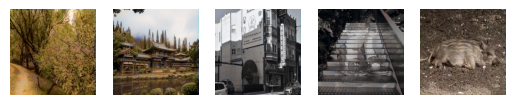

validation Output: 


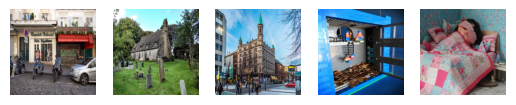

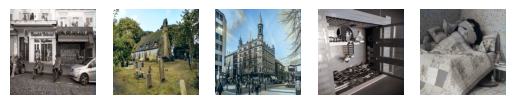


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2180.pth.
Train Epoch: 2181 [0/256 (0%)]	GanLoss: 0.347206	UNetLoss: 0.455080
Train Epoch: 2182 [0/256 (0%)]	GanLoss: 0.347471	UNetLoss: 0.445922
Train Epoch: 2183 [0/256 (0%)]	GanLoss: 0.347106	UNetLoss: 0.449387
Train Epoch: 2184 [0/256 (0%)]	GanLoss: 0.347095	UNetLoss: 0.451314
Train Epoch: 2185 [0/256 (0%)]	GanLoss: 0.347523	UNetLoss: 0.465330
Train Epoch: 2186 [0/256 (0%)]	GanLoss: 0.347091	UNetLoss: 0.445263
Train Epoch: 2187 [0/256 (0%)]	GanLoss: 0.347479	UNetLoss: 0.446365
Train Epoch: 2188 [0/256 (0%)]	GanLoss: 0.347900	UNetLoss: 0.459992
Train Epoch: 2189 [0/256 (0%)]	GanLoss: 0.346926	UNetLoss: 0.442557
Train Epoch: 2190 [0/256 (0%)]	GanLoss: 0.346535	UNetLoss: 0.458958
Training Output: 


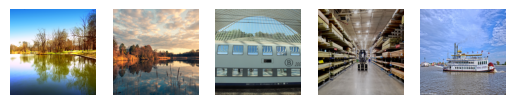

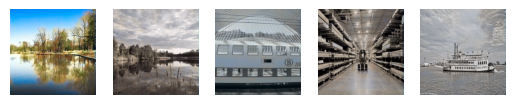

validation Output: 


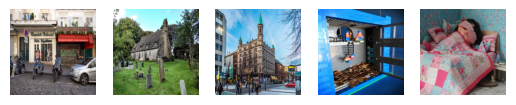

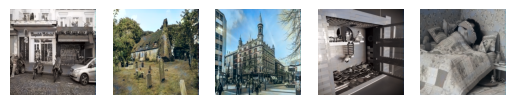


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2190.pth.
Train Epoch: 2191 [0/256 (0%)]	GanLoss: 0.346939	UNetLoss: 0.465273
Train Epoch: 2192 [0/256 (0%)]	GanLoss: 0.346907	UNetLoss: 0.449056
Train Epoch: 2193 [0/256 (0%)]	GanLoss: 0.347362	UNetLoss: 0.451397
Train Epoch: 2194 [0/256 (0%)]	GanLoss: 0.346370	UNetLoss: 0.437012
Train Epoch: 2195 [0/256 (0%)]	GanLoss: 0.346864	UNetLoss: 0.445891
Train Epoch: 2196 [0/256 (0%)]	GanLoss: 0.347167	UNetLoss: 0.450893
Train Epoch: 2197 [0/256 (0%)]	GanLoss: 0.346880	UNetLoss: 0.452156
Train Epoch: 2198 [0/256 (0%)]	GanLoss: 0.347274	UNetLoss: 0.462106
Train Epoch: 2199 [0/256 (0%)]	GanLoss: 0.346739	UNetLoss: 0.448135
Train Epoch: 2200 [0/256 (0%)]	GanLoss: 0.347978	UNetLoss: 0.452018
Training Output: 


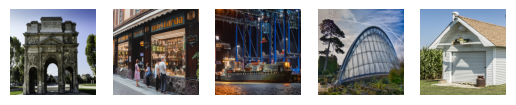

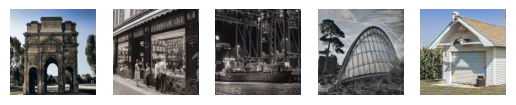

validation Output: 


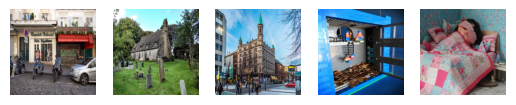

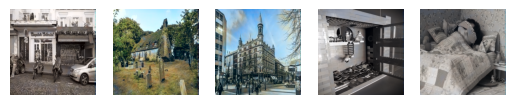


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2200.pth.
Train Epoch: 2201 [0/256 (0%)]	GanLoss: 0.346406	UNetLoss: 0.452736
Train Epoch: 2202 [0/256 (0%)]	GanLoss: 0.346476	UNetLoss: 0.447543
Train Epoch: 2203 [0/256 (0%)]	GanLoss: 0.346651	UNetLoss: 0.457345
Train Epoch: 2204 [0/256 (0%)]	GanLoss: 0.346140	UNetLoss: 0.447078
Train Epoch: 2205 [0/256 (0%)]	GanLoss: 0.346112	UNetLoss: 0.448252
Train Epoch: 2206 [0/256 (0%)]	GanLoss: 0.346848	UNetLoss: 0.467187
Train Epoch: 2207 [0/256 (0%)]	GanLoss: 0.346195	UNetLoss: 0.466204
Train Epoch: 2208 [0/256 (0%)]	GanLoss: 0.346029	UNetLoss: 0.446711
Train Epoch: 2209 [0/256 (0%)]	GanLoss: 0.346227	UNetLoss: 0.452283
Train Epoch: 2210 [0/256 (0%)]	GanLoss: 0.345938	UNetLoss: 0.452810
Training Output: 


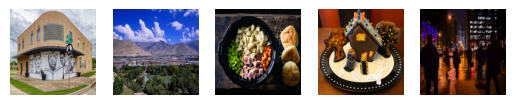

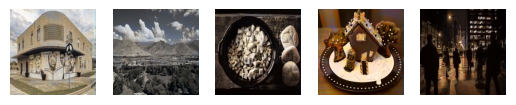

validation Output: 


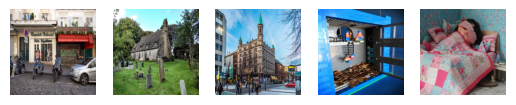

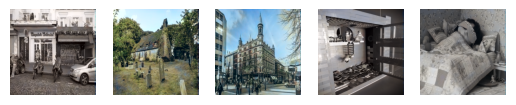


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2210.pth.
Train Epoch: 2211 [0/256 (0%)]	GanLoss: 0.346421	UNetLoss: 0.445069
Train Epoch: 2212 [0/256 (0%)]	GanLoss: 0.346117	UNetLoss: 0.448722
Train Epoch: 2213 [0/256 (0%)]	GanLoss: 0.346745	UNetLoss: 0.452817
Train Epoch: 2214 [0/256 (0%)]	GanLoss: 0.346112	UNetLoss: 0.447108
Train Epoch: 2215 [0/256 (0%)]	GanLoss: 0.345746	UNetLoss: 0.464726
Train Epoch: 2216 [0/256 (0%)]	GanLoss: 0.345960	UNetLoss: 0.466715
Train Epoch: 2217 [0/256 (0%)]	GanLoss: 0.346247	UNetLoss: 0.447929
Train Epoch: 2218 [0/256 (0%)]	GanLoss: 0.345858	UNetLoss: 0.444080
Train Epoch: 2219 [0/256 (0%)]	GanLoss: 0.345468	UNetLoss: 0.452041
Train Epoch: 2220 [0/256 (0%)]	GanLoss: 0.345984	UNetLoss: 0.446083
Training Output: 


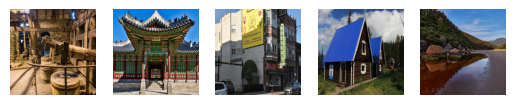

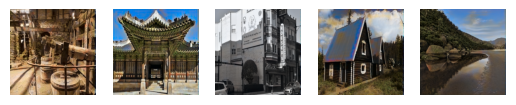

validation Output: 


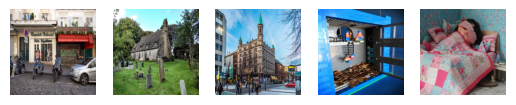

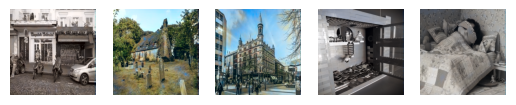


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2220.pth.
Train Epoch: 2221 [0/256 (0%)]	GanLoss: 0.346003	UNetLoss: 0.452866
Train Epoch: 2222 [0/256 (0%)]	GanLoss: 0.346210	UNetLoss: 0.467550
Train Epoch: 2223 [0/256 (0%)]	GanLoss: 0.345510	UNetLoss: 0.445548
Train Epoch: 2224 [0/256 (0%)]	GanLoss: 0.345689	UNetLoss: 0.466487
Train Epoch: 2225 [0/256 (0%)]	GanLoss: 0.345494	UNetLoss: 0.460244
Train Epoch: 2226 [0/256 (0%)]	GanLoss: 0.345415	UNetLoss: 0.450492
Train Epoch: 2227 [0/256 (0%)]	GanLoss: 0.345841	UNetLoss: 0.453226
Train Epoch: 2228 [0/256 (0%)]	GanLoss: 0.346034	UNetLoss: 0.447611
Train Epoch: 2229 [0/256 (0%)]	GanLoss: 0.345387	UNetLoss: 0.449747
Train Epoch: 2230 [0/256 (0%)]	GanLoss: 0.345517	UNetLoss: 0.451613
Training Output: 


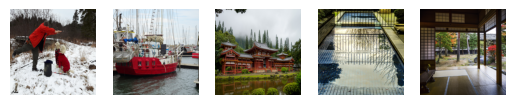

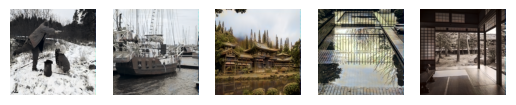

validation Output: 


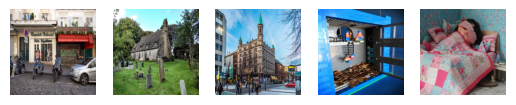

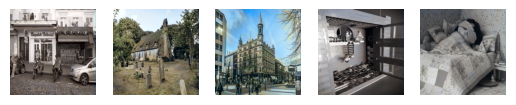


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2230.pth.
Train Epoch: 2231 [0/256 (0%)]	GanLoss: 0.346084	UNetLoss: 0.453876
Train Epoch: 2232 [0/256 (0%)]	GanLoss: 0.346236	UNetLoss: 0.456060
Train Epoch: 2233 [0/256 (0%)]	GanLoss: 0.346267	UNetLoss: 0.445520
Train Epoch: 2234 [0/256 (0%)]	GanLoss: 0.345791	UNetLoss: 0.461555
Train Epoch: 2235 [0/256 (0%)]	GanLoss: 0.344688	UNetLoss: 0.440148
Train Epoch: 2236 [0/256 (0%)]	GanLoss: 0.344909	UNetLoss: 0.451354
Train Epoch: 2237 [0/256 (0%)]	GanLoss: 0.345232	UNetLoss: 0.450183
Train Epoch: 2238 [0/256 (0%)]	GanLoss: 0.346204	UNetLoss: 0.442979
Train Epoch: 2239 [0/256 (0%)]	GanLoss: 0.345034	UNetLoss: 0.455926
Train Epoch: 2240 [0/256 (0%)]	GanLoss: 0.345384	UNetLoss: 0.459802
Training Output: 


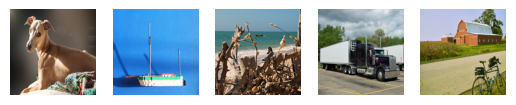

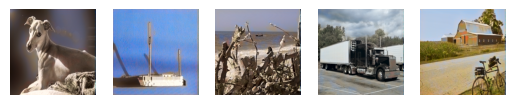

validation Output: 


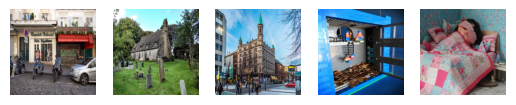

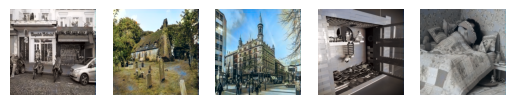


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2240.pth.
Train Epoch: 2241 [0/256 (0%)]	GanLoss: 0.344878	UNetLoss: 0.456536
Train Epoch: 2242 [0/256 (0%)]	GanLoss: 0.345024	UNetLoss: 0.449361
Train Epoch: 2243 [0/256 (0%)]	GanLoss: 0.344881	UNetLoss: 0.452032
Train Epoch: 2244 [0/256 (0%)]	GanLoss: 0.344765	UNetLoss: 0.449961
Train Epoch: 2245 [0/256 (0%)]	GanLoss: 0.344708	UNetLoss: 0.446795
Train Epoch: 2246 [0/256 (0%)]	GanLoss: 0.345376	UNetLoss: 0.468848
Train Epoch: 2247 [0/256 (0%)]	GanLoss: 0.344885	UNetLoss: 0.440416
Train Epoch: 2248 [0/256 (0%)]	GanLoss: 0.344616	UNetLoss: 0.445690
Train Epoch: 2249 [0/256 (0%)]	GanLoss: 0.344183	UNetLoss: 0.435818
Train Epoch: 2250 [0/256 (0%)]	GanLoss: 0.344136	UNetLoss: 0.453053
Training Output: 


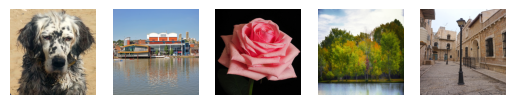

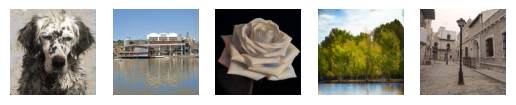

validation Output: 


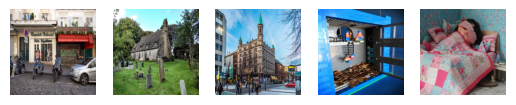

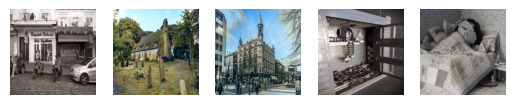


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2250.pth.
Train Epoch: 2251 [0/256 (0%)]	GanLoss: 0.344313	UNetLoss: 0.445403
Train Epoch: 2252 [0/256 (0%)]	GanLoss: 0.344077	UNetLoss: 0.442745
Train Epoch: 2253 [0/256 (0%)]	GanLoss: 0.344317	UNetLoss: 0.467288
Train Epoch: 2254 [0/256 (0%)]	GanLoss: 0.344832	UNetLoss: 0.449115
Train Epoch: 2255 [0/256 (0%)]	GanLoss: 0.344472	UNetLoss: 0.455029
Train Epoch: 2256 [0/256 (0%)]	GanLoss: 0.344263	UNetLoss: 0.448019
Train Epoch: 2257 [0/256 (0%)]	GanLoss: 0.344562	UNetLoss: 0.459217
Train Epoch: 2258 [0/256 (0%)]	GanLoss: 0.344346	UNetLoss: 0.468755
Train Epoch: 2259 [0/256 (0%)]	GanLoss: 0.344359	UNetLoss: 0.458502
Train Epoch: 2260 [0/256 (0%)]	GanLoss: 0.344432	UNetLoss: 0.456767
Training Output: 


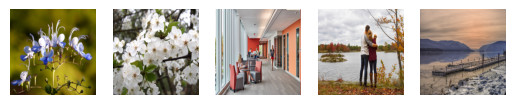

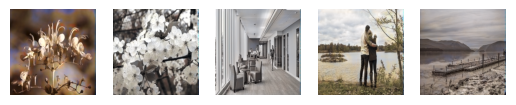

validation Output: 


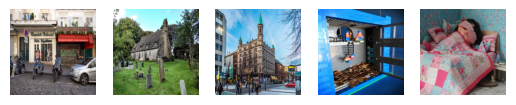

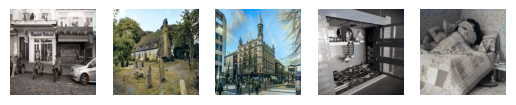


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2260.pth.
Train Epoch: 2261 [0/256 (0%)]	GanLoss: 0.343575	UNetLoss: 0.456805
Train Epoch: 2262 [0/256 (0%)]	GanLoss: 0.343674	UNetLoss: 0.455382
Train Epoch: 2263 [0/256 (0%)]	GanLoss: 0.343700	UNetLoss: 0.446632
Train Epoch: 2264 [0/256 (0%)]	GanLoss: 0.344077	UNetLoss: 0.440621
Train Epoch: 2265 [0/256 (0%)]	GanLoss: 0.343277	UNetLoss: 0.452182
Train Epoch: 2266 [0/256 (0%)]	GanLoss: 0.343690	UNetLoss: 0.452576
Train Epoch: 2267 [0/256 (0%)]	GanLoss: 0.343907	UNetLoss: 0.441622
Train Epoch: 2268 [0/256 (0%)]	GanLoss: 0.343256	UNetLoss: 0.438826
Train Epoch: 2269 [0/256 (0%)]	GanLoss: 0.343800	UNetLoss: 0.465235
Train Epoch: 2270 [0/256 (0%)]	GanLoss: 0.343398	UNetLoss: 0.439886
Training Output: 


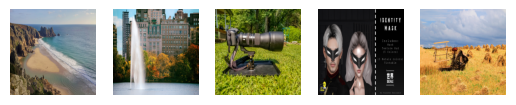

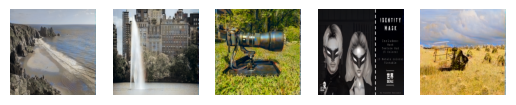

validation Output: 


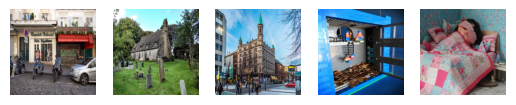

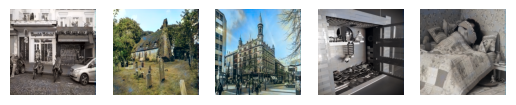


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2270.pth.
Train Epoch: 2271 [0/256 (0%)]	GanLoss: 0.343994	UNetLoss: 0.432351
Train Epoch: 2272 [0/256 (0%)]	GanLoss: 0.343701	UNetLoss: 0.451896
Train Epoch: 2273 [0/256 (0%)]	GanLoss: 0.343272	UNetLoss: 0.444812
Train Epoch: 2274 [0/256 (0%)]	GanLoss: 0.343370	UNetLoss: 0.450246
Train Epoch: 2275 [0/256 (0%)]	GanLoss: 0.342789	UNetLoss: 0.458348
Train Epoch: 2276 [0/256 (0%)]	GanLoss: 0.343528	UNetLoss: 0.449106
Train Epoch: 2277 [0/256 (0%)]	GanLoss: 0.342922	UNetLoss: 0.444768
Train Epoch: 2278 [0/256 (0%)]	GanLoss: 0.343101	UNetLoss: 0.440815
Train Epoch: 2279 [0/256 (0%)]	GanLoss: 0.343345	UNetLoss: 0.451763
Train Epoch: 2280 [0/256 (0%)]	GanLoss: 0.343050	UNetLoss: 0.464898
Training Output: 


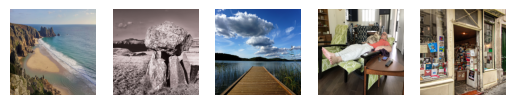

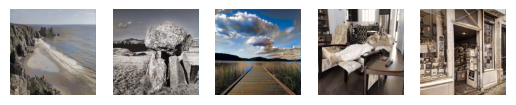

validation Output: 


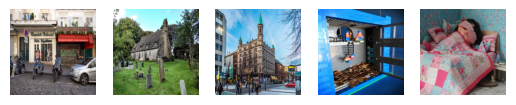

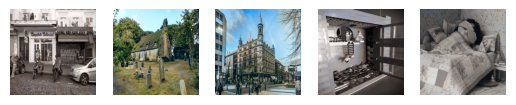


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2280.pth.
Train Epoch: 2281 [0/256 (0%)]	GanLoss: 0.343243	UNetLoss: 0.454910
Train Epoch: 2282 [0/256 (0%)]	GanLoss: 0.342806	UNetLoss: 0.455424
Train Epoch: 2283 [0/256 (0%)]	GanLoss: 0.343087	UNetLoss: 0.447912
Train Epoch: 2284 [0/256 (0%)]	GanLoss: 0.342279	UNetLoss: 0.440451
Train Epoch: 2285 [0/256 (0%)]	GanLoss: 0.343021	UNetLoss: 0.439846
Train Epoch: 2286 [0/256 (0%)]	GanLoss: 0.342703	UNetLoss: 0.460259
Train Epoch: 2287 [0/256 (0%)]	GanLoss: 0.342691	UNetLoss: 0.440895
Train Epoch: 2288 [0/256 (0%)]	GanLoss: 0.342560	UNetLoss: 0.456629
Train Epoch: 2289 [0/256 (0%)]	GanLoss: 0.342772	UNetLoss: 0.456022
Train Epoch: 2290 [0/256 (0%)]	GanLoss: 0.342700	UNetLoss: 0.447948
Training Output: 


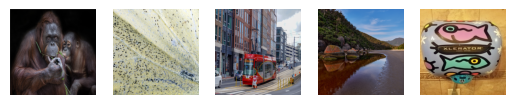

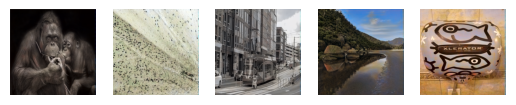

validation Output: 


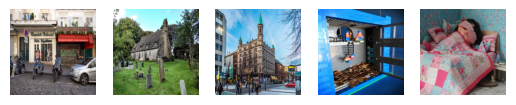

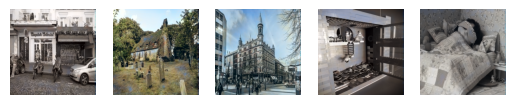


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2290.pth.
Train Epoch: 2291 [0/256 (0%)]	GanLoss: 0.342865	UNetLoss: 0.460123
Train Epoch: 2292 [0/256 (0%)]	GanLoss: 0.342602	UNetLoss: 0.439862
Train Epoch: 2293 [0/256 (0%)]	GanLoss: 0.342550	UNetLoss: 0.451184
Train Epoch: 2294 [0/256 (0%)]	GanLoss: 0.342263	UNetLoss: 0.446682
Train Epoch: 2295 [0/256 (0%)]	GanLoss: 0.342832	UNetLoss: 0.446756
Train Epoch: 2296 [0/256 (0%)]	GanLoss: 0.342631	UNetLoss: 0.443732
Train Epoch: 2297 [0/256 (0%)]	GanLoss: 0.342530	UNetLoss: 0.442804
Train Epoch: 2298 [0/256 (0%)]	GanLoss: 0.342325	UNetLoss: 0.456017
Train Epoch: 2299 [0/256 (0%)]	GanLoss: 0.342169	UNetLoss: 0.440946
Train Epoch: 2300 [0/256 (0%)]	GanLoss: 0.342025	UNetLoss: 0.453081
Training Output: 


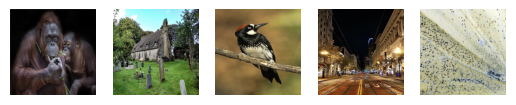

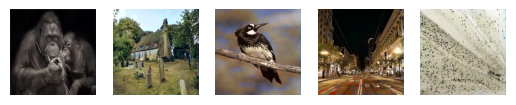

validation Output: 


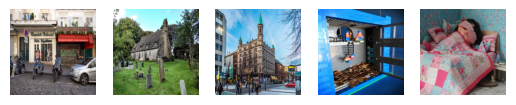

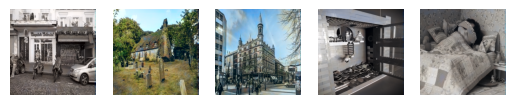


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2300.pth.
Train Epoch: 2301 [0/256 (0%)]	GanLoss: 0.342356	UNetLoss: 0.437558
Train Epoch: 2302 [0/256 (0%)]	GanLoss: 0.341959	UNetLoss: 0.433071
Train Epoch: 2303 [0/256 (0%)]	GanLoss: 0.342479	UNetLoss: 0.448545
Train Epoch: 2304 [0/256 (0%)]	GanLoss: 0.342388	UNetLoss: 0.438302
Train Epoch: 2305 [0/256 (0%)]	GanLoss: 0.341575	UNetLoss: 0.446439
Train Epoch: 2306 [0/256 (0%)]	GanLoss: 0.342028	UNetLoss: 0.447661
Train Epoch: 2307 [0/256 (0%)]	GanLoss: 0.341944	UNetLoss: 0.445511
Train Epoch: 2308 [0/256 (0%)]	GanLoss: 0.341877	UNetLoss: 0.441116
Train Epoch: 2309 [0/256 (0%)]	GanLoss: 0.342009	UNetLoss: 0.448055
Train Epoch: 2310 [0/256 (0%)]	GanLoss: 0.341652	UNetLoss: 0.452017
Training Output: 


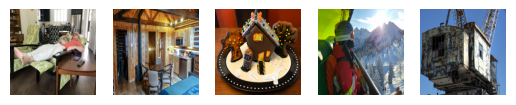

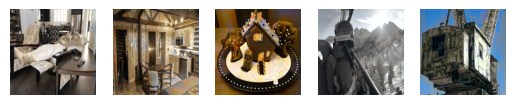

validation Output: 


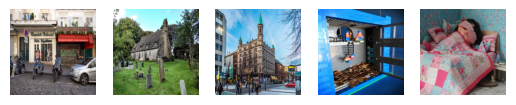

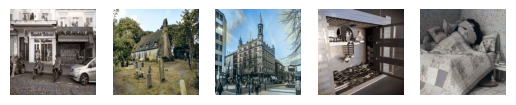


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2310.pth.
Train Epoch: 2311 [0/256 (0%)]	GanLoss: 0.341917	UNetLoss: 0.457845
Train Epoch: 2312 [0/256 (0%)]	GanLoss: 0.341424	UNetLoss: 0.446354
Train Epoch: 2313 [0/256 (0%)]	GanLoss: 0.341464	UNetLoss: 0.447556
Train Epoch: 2314 [0/256 (0%)]	GanLoss: 0.341498	UNetLoss: 0.445605
Train Epoch: 2315 [0/256 (0%)]	GanLoss: 0.341330	UNetLoss: 0.444285
Train Epoch: 2316 [0/256 (0%)]	GanLoss: 0.341693	UNetLoss: 0.433291
Train Epoch: 2317 [0/256 (0%)]	GanLoss: 0.341227	UNetLoss: 0.438135
Train Epoch: 2318 [0/256 (0%)]	GanLoss: 0.341573	UNetLoss: 0.443262
Train Epoch: 2319 [0/256 (0%)]	GanLoss: 0.341200	UNetLoss: 0.440758
Train Epoch: 2320 [0/256 (0%)]	GanLoss: 0.340632	UNetLoss: 0.440567
Training Output: 


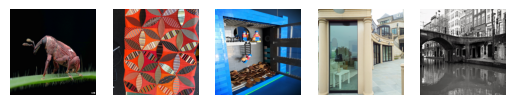

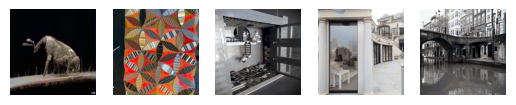

validation Output: 


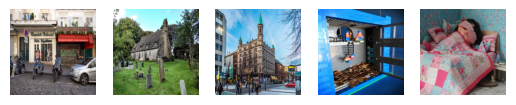

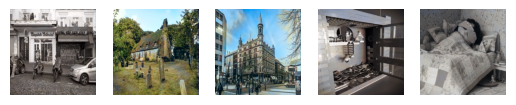


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2320.pth.
Train Epoch: 2321 [0/256 (0%)]	GanLoss: 0.341154	UNetLoss: 0.422688
Train Epoch: 2322 [0/256 (0%)]	GanLoss: 0.341563	UNetLoss: 0.443398
Train Epoch: 2323 [0/256 (0%)]	GanLoss: 0.341820	UNetLoss: 0.458320
Train Epoch: 2324 [0/256 (0%)]	GanLoss: 0.341211	UNetLoss: 0.442014
Train Epoch: 2325 [0/256 (0%)]	GanLoss: 0.341262	UNetLoss: 0.463693
Train Epoch: 2326 [0/256 (0%)]	GanLoss: 0.341001	UNetLoss: 0.452820
Train Epoch: 2327 [0/256 (0%)]	GanLoss: 0.340807	UNetLoss: 0.452174
Train Epoch: 2328 [0/256 (0%)]	GanLoss: 0.340907	UNetLoss: 0.439019
Train Epoch: 2329 [0/256 (0%)]	GanLoss: 0.340606	UNetLoss: 0.442201
Train Epoch: 2330 [0/256 (0%)]	GanLoss: 0.340478	UNetLoss: 0.456043
Training Output: 


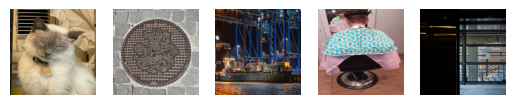

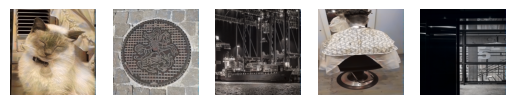

validation Output: 


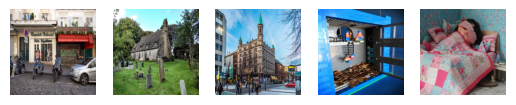

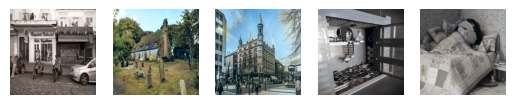


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2330.pth.
Train Epoch: 2331 [0/256 (0%)]	GanLoss: 0.341319	UNetLoss: 0.437976
Train Epoch: 2332 [0/256 (0%)]	GanLoss: 0.340438	UNetLoss: 0.448423
Train Epoch: 2333 [0/256 (0%)]	GanLoss: 0.340571	UNetLoss: 0.431940
Train Epoch: 2334 [0/256 (0%)]	GanLoss: 0.340859	UNetLoss: 0.442537
Train Epoch: 2335 [0/256 (0%)]	GanLoss: 0.340320	UNetLoss: 0.440664
Train Epoch: 2336 [0/256 (0%)]	GanLoss: 0.340923	UNetLoss: 0.444338
Train Epoch: 2337 [0/256 (0%)]	GanLoss: 0.340112	UNetLoss: 0.437768
Train Epoch: 2338 [0/256 (0%)]	GanLoss: 0.341221	UNetLoss: 0.444892
Train Epoch: 2339 [0/256 (0%)]	GanLoss: 0.340497	UNetLoss: 0.443414
Train Epoch: 2340 [0/256 (0%)]	GanLoss: 0.340141	UNetLoss: 0.443875
Training Output: 


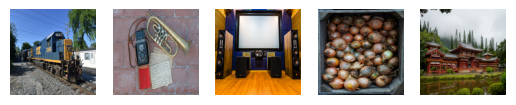

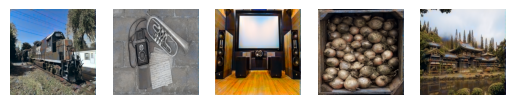

validation Output: 


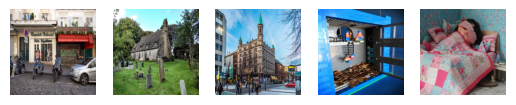

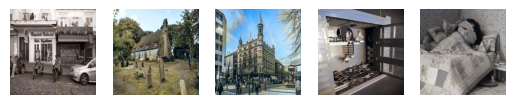


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2340.pth.
Train Epoch: 2341 [0/256 (0%)]	GanLoss: 0.339944	UNetLoss: 0.454482
Train Epoch: 2342 [0/256 (0%)]	GanLoss: 0.340446	UNetLoss: 0.427448
Train Epoch: 2343 [0/256 (0%)]	GanLoss: 0.339860	UNetLoss: 0.433721
Train Epoch: 2344 [0/256 (0%)]	GanLoss: 0.339756	UNetLoss: 0.443622
Train Epoch: 2345 [0/256 (0%)]	GanLoss: 0.339713	UNetLoss: 0.437514
Train Epoch: 2346 [0/256 (0%)]	GanLoss: 0.339347	UNetLoss: 0.454852
Train Epoch: 2347 [0/256 (0%)]	GanLoss: 0.339589	UNetLoss: 0.430343
Train Epoch: 2348 [0/256 (0%)]	GanLoss: 0.339732	UNetLoss: 0.443553
Train Epoch: 2349 [0/256 (0%)]	GanLoss: 0.340191	UNetLoss: 0.434983
Train Epoch: 2350 [0/256 (0%)]	GanLoss: 0.340114	UNetLoss: 0.441089
Training Output: 


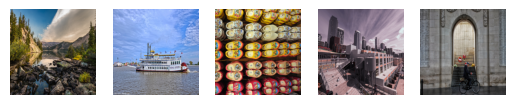

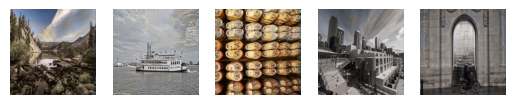

validation Output: 


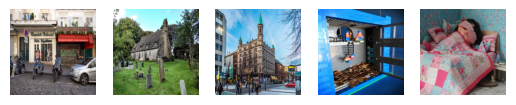

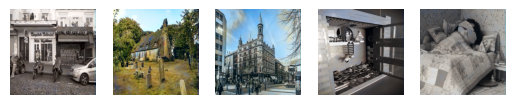


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2350.pth.
Train Epoch: 2351 [0/256 (0%)]	GanLoss: 0.339597	UNetLoss: 0.434092
Train Epoch: 2352 [0/256 (0%)]	GanLoss: 0.339399	UNetLoss: 0.449931
Train Epoch: 2353 [0/256 (0%)]	GanLoss: 0.339867	UNetLoss: 0.443144
Train Epoch: 2354 [0/256 (0%)]	GanLoss: 0.339276	UNetLoss: 0.452069
Train Epoch: 2355 [0/256 (0%)]	GanLoss: 0.339601	UNetLoss: 0.442289
Train Epoch: 2356 [0/256 (0%)]	GanLoss: 0.339224	UNetLoss: 0.432832
Train Epoch: 2357 [0/256 (0%)]	GanLoss: 0.339097	UNetLoss: 0.433996
Train Epoch: 2358 [0/256 (0%)]	GanLoss: 0.339081	UNetLoss: 0.446956
Train Epoch: 2359 [0/256 (0%)]	GanLoss: 0.339222	UNetLoss: 0.435228
Train Epoch: 2360 [0/256 (0%)]	GanLoss: 0.339151	UNetLoss: 0.441453
Training Output: 


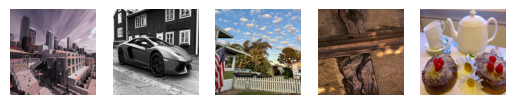

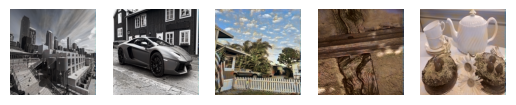

validation Output: 


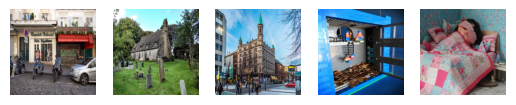

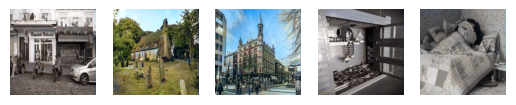


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2360.pth.
Train Epoch: 2361 [0/256 (0%)]	GanLoss: 0.338936	UNetLoss: 0.446614
Train Epoch: 2362 [0/256 (0%)]	GanLoss: 0.339905	UNetLoss: 0.435522
Train Epoch: 2363 [0/256 (0%)]	GanLoss: 0.338808	UNetLoss: 0.430141
Train Epoch: 2364 [0/256 (0%)]	GanLoss: 0.339212	UNetLoss: 0.434324
Train Epoch: 2365 [0/256 (0%)]	GanLoss: 0.339288	UNetLoss: 0.439812
Train Epoch: 2366 [0/256 (0%)]	GanLoss: 0.338825	UNetLoss: 0.436652
Train Epoch: 2367 [0/256 (0%)]	GanLoss: 0.338865	UNetLoss: 0.444436
Train Epoch: 2368 [0/256 (0%)]	GanLoss: 0.338649	UNetLoss: 0.447827
Train Epoch: 2369 [0/256 (0%)]	GanLoss: 0.338373	UNetLoss: 0.433894
Train Epoch: 2370 [0/256 (0%)]	GanLoss: 0.338697	UNetLoss: 0.445376
Training Output: 


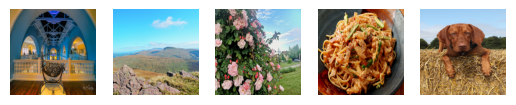

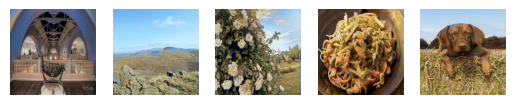

validation Output: 


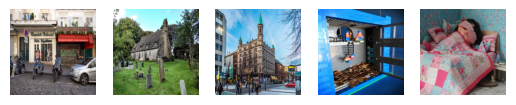

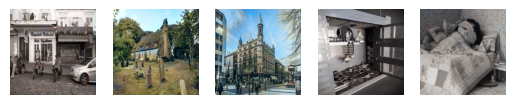


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2370.pth.
Train Epoch: 2371 [0/256 (0%)]	GanLoss: 0.339603	UNetLoss: 0.443601
Train Epoch: 2372 [0/256 (0%)]	GanLoss: 0.338933	UNetLoss: 0.437658
Train Epoch: 2373 [0/256 (0%)]	GanLoss: 0.338630	UNetLoss: 0.445462
Train Epoch: 2374 [0/256 (0%)]	GanLoss: 0.338448	UNetLoss: 0.431118
Train Epoch: 2375 [0/256 (0%)]	GanLoss: 0.339021	UNetLoss: 0.442424
Train Epoch: 2376 [0/256 (0%)]	GanLoss: 0.338310	UNetLoss: 0.433891
Train Epoch: 2377 [0/256 (0%)]	GanLoss: 0.338451	UNetLoss: 0.439969
Train Epoch: 2378 [0/256 (0%)]	GanLoss: 0.338499	UNetLoss: 0.450079
Train Epoch: 2379 [0/256 (0%)]	GanLoss: 0.338920	UNetLoss: 0.431997
Train Epoch: 2380 [0/256 (0%)]	GanLoss: 0.338400	UNetLoss: 0.446685
Training Output: 


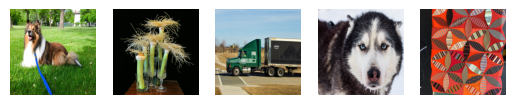

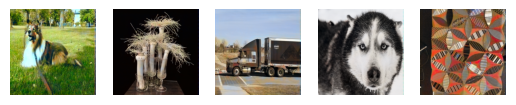

validation Output: 


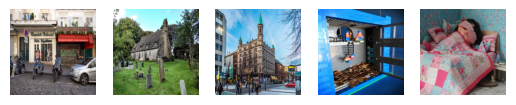

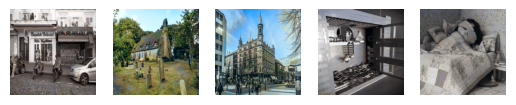


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2380.pth.
Train Epoch: 2381 [0/256 (0%)]	GanLoss: 0.338877	UNetLoss: 0.444790
Train Epoch: 2382 [0/256 (0%)]	GanLoss: 0.338515	UNetLoss: 0.457045
Train Epoch: 2383 [0/256 (0%)]	GanLoss: 0.337941	UNetLoss: 0.439800
Train Epoch: 2384 [0/256 (0%)]	GanLoss: 0.337923	UNetLoss: 0.430392
Train Epoch: 2385 [0/256 (0%)]	GanLoss: 0.337719	UNetLoss: 0.421306
Train Epoch: 2386 [0/256 (0%)]	GanLoss: 0.337867	UNetLoss: 0.447182
Train Epoch: 2387 [0/256 (0%)]	GanLoss: 0.337647	UNetLoss: 0.432871
Train Epoch: 2388 [0/256 (0%)]	GanLoss: 0.337994	UNetLoss: 0.438140
Train Epoch: 2389 [0/256 (0%)]	GanLoss: 0.337849	UNetLoss: 0.445588
Train Epoch: 2390 [0/256 (0%)]	GanLoss: 0.338408	UNetLoss: 0.438028
Training Output: 


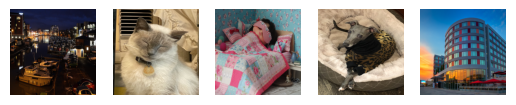

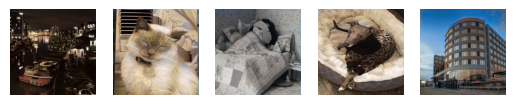

validation Output: 


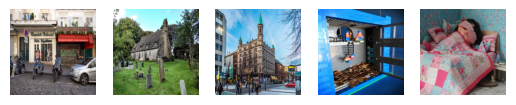

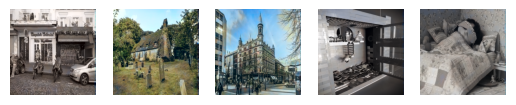


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2390.pth.
Train Epoch: 2391 [0/256 (0%)]	GanLoss: 0.337601	UNetLoss: 0.430421
Train Epoch: 2392 [0/256 (0%)]	GanLoss: 0.337362	UNetLoss: 0.435875
Train Epoch: 2393 [0/256 (0%)]	GanLoss: 0.337363	UNetLoss: 0.429954
Train Epoch: 2394 [0/256 (0%)]	GanLoss: 0.337359	UNetLoss: 0.447874
Train Epoch: 2395 [0/256 (0%)]	GanLoss: 0.337446	UNetLoss: 0.428197
Train Epoch: 2396 [0/256 (0%)]	GanLoss: 0.337030	UNetLoss: 0.439184
Train Epoch: 2397 [0/256 (0%)]	GanLoss: 0.337795	UNetLoss: 0.422397
Train Epoch: 2398 [0/256 (0%)]	GanLoss: 0.337540	UNetLoss: 0.445401
Train Epoch: 2399 [0/256 (0%)]	GanLoss: 0.337364	UNetLoss: 0.449523
Train Epoch: 2400 [0/256 (0%)]	GanLoss: 0.337480	UNetLoss: 0.438548
Training Output: 


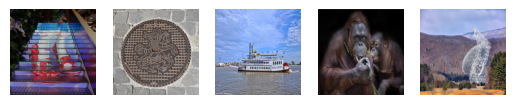

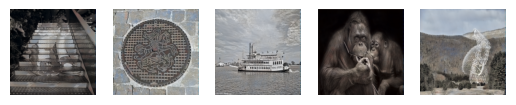

validation Output: 


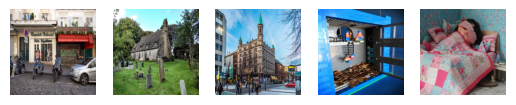

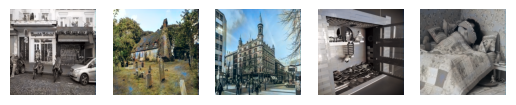


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2400.pth.
Train Epoch: 2401 [0/256 (0%)]	GanLoss: 0.337555	UNetLoss: 0.438960
Train Epoch: 2402 [0/256 (0%)]	GanLoss: 0.337150	UNetLoss: 0.432258
Train Epoch: 2403 [0/256 (0%)]	GanLoss: 0.337330	UNetLoss: 0.442501
Train Epoch: 2404 [0/256 (0%)]	GanLoss: 0.337655	UNetLoss: 0.453909
Train Epoch: 2405 [0/256 (0%)]	GanLoss: 0.337281	UNetLoss: 0.444505
Train Epoch: 2406 [0/256 (0%)]	GanLoss: 0.336863	UNetLoss: 0.440161
Train Epoch: 2407 [0/256 (0%)]	GanLoss: 0.337084	UNetLoss: 0.429139
Train Epoch: 2408 [0/256 (0%)]	GanLoss: 0.336753	UNetLoss: 0.450359
Train Epoch: 2409 [0/256 (0%)]	GanLoss: 0.336437	UNetLoss: 0.435441
Train Epoch: 2410 [0/256 (0%)]	GanLoss: 0.336812	UNetLoss: 0.433419
Training Output: 


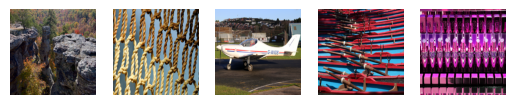

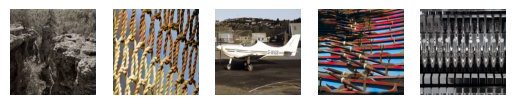

validation Output: 


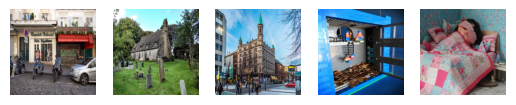

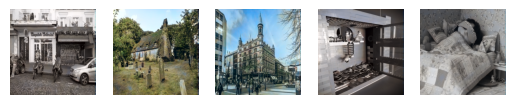


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2410.pth.
Train Epoch: 2411 [0/256 (0%)]	GanLoss: 0.336916	UNetLoss: 0.443241
Train Epoch: 2412 [0/256 (0%)]	GanLoss: 0.336442	UNetLoss: 0.442893
Train Epoch: 2413 [0/256 (0%)]	GanLoss: 0.336464	UNetLoss: 0.429963
Train Epoch: 2414 [0/256 (0%)]	GanLoss: 0.337219	UNetLoss: 0.445229
Train Epoch: 2415 [0/256 (0%)]	GanLoss: 0.336636	UNetLoss: 0.433049
Train Epoch: 2416 [0/256 (0%)]	GanLoss: 0.336495	UNetLoss: 0.440206
Train Epoch: 2417 [0/256 (0%)]	GanLoss: 0.336700	UNetLoss: 0.437443
Train Epoch: 2418 [0/256 (0%)]	GanLoss: 0.336319	UNetLoss: 0.425973
Train Epoch: 2419 [0/256 (0%)]	GanLoss: 0.336796	UNetLoss: 0.433819
Train Epoch: 2420 [0/256 (0%)]	GanLoss: 0.336461	UNetLoss: 0.449329
Training Output: 


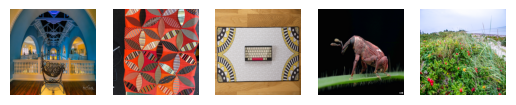

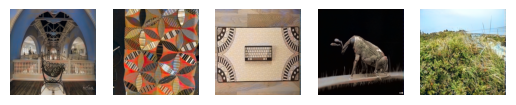

validation Output: 


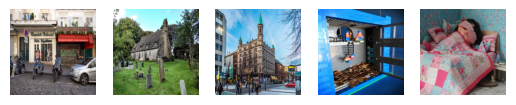

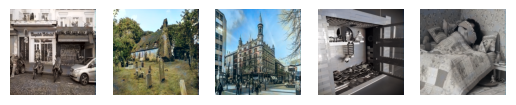


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2420.pth.
Train Epoch: 2421 [0/256 (0%)]	GanLoss: 0.336380	UNetLoss: 0.438687
Train Epoch: 2422 [0/256 (0%)]	GanLoss: 0.336571	UNetLoss: 0.434165
Train Epoch: 2423 [0/256 (0%)]	GanLoss: 0.336443	UNetLoss: 0.424451
Train Epoch: 2424 [0/256 (0%)]	GanLoss: 0.336471	UNetLoss: 0.429939
Train Epoch: 2425 [0/256 (0%)]	GanLoss: 0.336363	UNetLoss: 0.438948
Train Epoch: 2426 [0/256 (0%)]	GanLoss: 0.336306	UNetLoss: 0.428092
Train Epoch: 2427 [0/256 (0%)]	GanLoss: 0.336092	UNetLoss: 0.444335
Train Epoch: 2428 [0/256 (0%)]	GanLoss: 0.335588	UNetLoss: 0.425833
Train Epoch: 2429 [0/256 (0%)]	GanLoss: 0.336143	UNetLoss: 0.442277
Train Epoch: 2430 [0/256 (0%)]	GanLoss: 0.335771	UNetLoss: 0.437099
Training Output: 


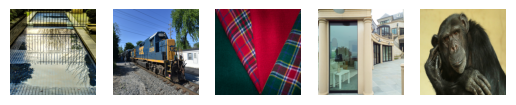

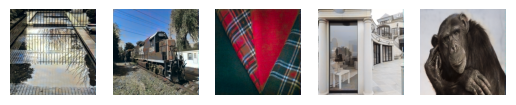

validation Output: 


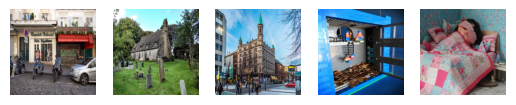

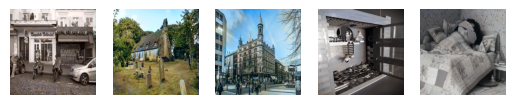


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2430.pth.
Train Epoch: 2431 [0/256 (0%)]	GanLoss: 0.336116	UNetLoss: 0.444346
Train Epoch: 2432 [0/256 (0%)]	GanLoss: 0.335686	UNetLoss: 0.438198
Train Epoch: 2433 [0/256 (0%)]	GanLoss: 0.336051	UNetLoss: 0.428570
Train Epoch: 2434 [0/256 (0%)]	GanLoss: 0.335747	UNetLoss: 0.431694
Train Epoch: 2435 [0/256 (0%)]	GanLoss: 0.335603	UNetLoss: 0.426165
Train Epoch: 2436 [0/256 (0%)]	GanLoss: 0.335659	UNetLoss: 0.433253
Train Epoch: 2437 [0/256 (0%)]	GanLoss: 0.335960	UNetLoss: 0.423961
Train Epoch: 2438 [0/256 (0%)]	GanLoss: 0.336407	UNetLoss: 0.438196
Train Epoch: 2439 [0/256 (0%)]	GanLoss: 0.336017	UNetLoss: 0.447724
Train Epoch: 2440 [0/256 (0%)]	GanLoss: 0.335791	UNetLoss: 0.433434
Training Output: 


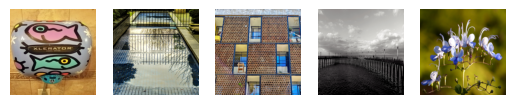

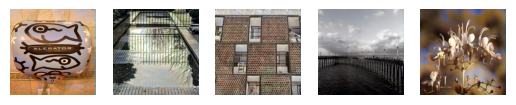

validation Output: 


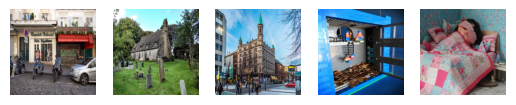

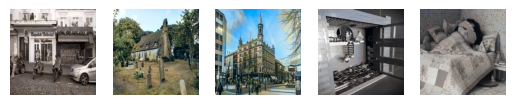


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2440.pth.
Train Epoch: 2441 [0/256 (0%)]	GanLoss: 0.335173	UNetLoss: 0.439550
Train Epoch: 2442 [0/256 (0%)]	GanLoss: 0.335458	UNetLoss: 0.457021
Train Epoch: 2443 [0/256 (0%)]	GanLoss: 0.335569	UNetLoss: 0.441025
Train Epoch: 2444 [0/256 (0%)]	GanLoss: 0.335540	UNetLoss: 0.432532
Train Epoch: 2445 [0/256 (0%)]	GanLoss: 0.335150	UNetLoss: 0.444243
Train Epoch: 2446 [0/256 (0%)]	GanLoss: 0.335567	UNetLoss: 0.444290
Train Epoch: 2447 [0/256 (0%)]	GanLoss: 0.335185	UNetLoss: 0.439271
Train Epoch: 2448 [0/256 (0%)]	GanLoss: 0.335347	UNetLoss: 0.438539
Train Epoch: 2449 [0/256 (0%)]	GanLoss: 0.335408	UNetLoss: 0.432363
Train Epoch: 2450 [0/256 (0%)]	GanLoss: 0.335329	UNetLoss: 0.440176
Training Output: 


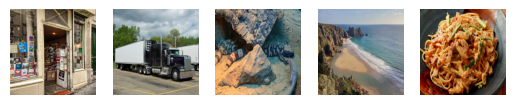

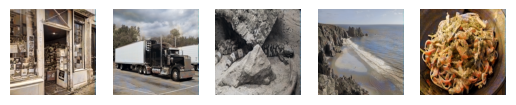

validation Output: 


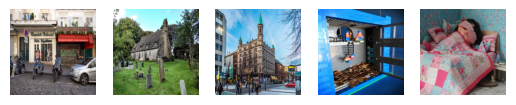

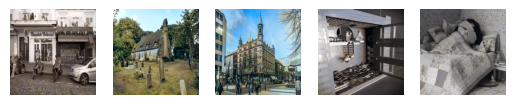


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2450.pth.
Train Epoch: 2451 [0/256 (0%)]	GanLoss: 0.335137	UNetLoss: 0.443074
Train Epoch: 2452 [0/256 (0%)]	GanLoss: 0.335778	UNetLoss: 0.431189
Train Epoch: 2453 [0/256 (0%)]	GanLoss: 0.335341	UNetLoss: 0.433421
Train Epoch: 2454 [0/256 (0%)]	GanLoss: 0.334518	UNetLoss: 0.429196
Train Epoch: 2455 [0/256 (0%)]	GanLoss: 0.334942	UNetLoss: 0.445793
Train Epoch: 2456 [0/256 (0%)]	GanLoss: 0.334523	UNetLoss: 0.435286
Train Epoch: 2457 [0/256 (0%)]	GanLoss: 0.334738	UNetLoss: 0.427283
Train Epoch: 2458 [0/256 (0%)]	GanLoss: 0.334487	UNetLoss: 0.422071
Train Epoch: 2459 [0/256 (0%)]	GanLoss: 0.335296	UNetLoss: 0.439163
Train Epoch: 2460 [0/256 (0%)]	GanLoss: 0.334983	UNetLoss: 0.434096
Training Output: 


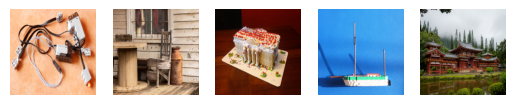

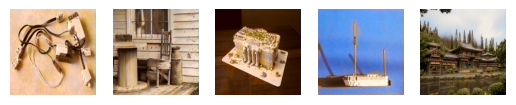

validation Output: 


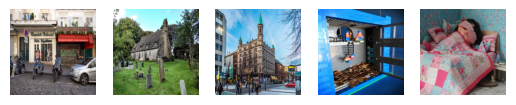

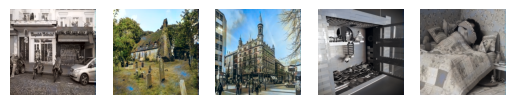


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2460.pth.
Train Epoch: 2461 [0/256 (0%)]	GanLoss: 0.334527	UNetLoss: 0.435527
Train Epoch: 2462 [0/256 (0%)]	GanLoss: 0.334597	UNetLoss: 0.430407
Train Epoch: 2463 [0/256 (0%)]	GanLoss: 0.334486	UNetLoss: 0.434577
Train Epoch: 2464 [0/256 (0%)]	GanLoss: 0.334554	UNetLoss: 0.436510
Train Epoch: 2465 [0/256 (0%)]	GanLoss: 0.334700	UNetLoss: 0.433571
Train Epoch: 2466 [0/256 (0%)]	GanLoss: 0.334316	UNetLoss: 0.431582
Train Epoch: 2467 [0/256 (0%)]	GanLoss: 0.334235	UNetLoss: 0.439439
Train Epoch: 2468 [0/256 (0%)]	GanLoss: 0.334473	UNetLoss: 0.433981
Train Epoch: 2469 [0/256 (0%)]	GanLoss: 0.334820	UNetLoss: 0.428462
Train Epoch: 2470 [0/256 (0%)]	GanLoss: 0.334055	UNetLoss: 0.430045
Training Output: 


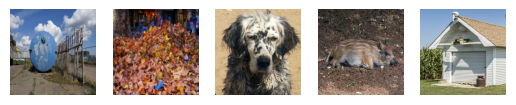

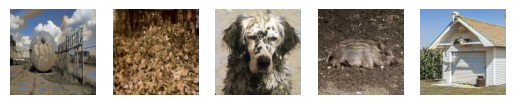

validation Output: 


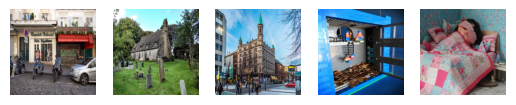

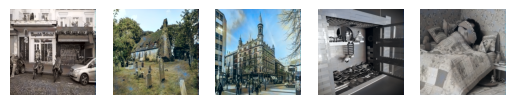


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2470.pth.
Train Epoch: 2471 [0/256 (0%)]	GanLoss: 0.334319	UNetLoss: 0.450831
Train Epoch: 2472 [0/256 (0%)]	GanLoss: 0.334341	UNetLoss: 0.432073
Train Epoch: 2473 [0/256 (0%)]	GanLoss: 0.334558	UNetLoss: 0.438607
Train Epoch: 2474 [0/256 (0%)]	GanLoss: 0.334115	UNetLoss: 0.433430
Train Epoch: 2475 [0/256 (0%)]	GanLoss: 0.334108	UNetLoss: 0.427982
Train Epoch: 2476 [0/256 (0%)]	GanLoss: 0.334083	UNetLoss: 0.434931
Train Epoch: 2477 [0/256 (0%)]	GanLoss: 0.333992	UNetLoss: 0.438462
Train Epoch: 2478 [0/256 (0%)]	GanLoss: 0.334425	UNetLoss: 0.427541
Train Epoch: 2479 [0/256 (0%)]	GanLoss: 0.334219	UNetLoss: 0.431750
Train Epoch: 2480 [0/256 (0%)]	GanLoss: 0.335406	UNetLoss: 0.452615
Training Output: 


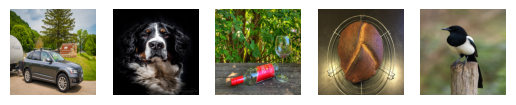

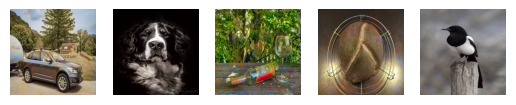

validation Output: 


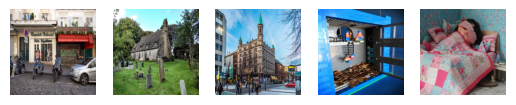

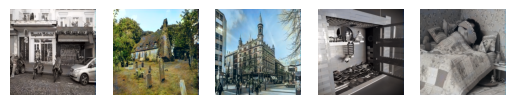


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2480.pth.
Train Epoch: 2481 [0/256 (0%)]	GanLoss: 0.336435	UNetLoss: 0.434929
Train Epoch: 2482 [0/256 (0%)]	GanLoss: 0.336716	UNetLoss: 0.439433
Train Epoch: 2483 [0/256 (0%)]	GanLoss: 0.334321	UNetLoss: 0.433004
Train Epoch: 2484 [0/256 (0%)]	GanLoss: 0.333785	UNetLoss: 0.436224
Train Epoch: 2485 [0/256 (0%)]	GanLoss: 0.333551	UNetLoss: 0.427349
Train Epoch: 2486 [0/256 (0%)]	GanLoss: 0.333673	UNetLoss: 0.419675
Train Epoch: 2487 [0/256 (0%)]	GanLoss: 0.333318	UNetLoss: 0.439724
Train Epoch: 2488 [0/256 (0%)]	GanLoss: 0.333493	UNetLoss: 0.431814
Train Epoch: 2489 [0/256 (0%)]	GanLoss: 0.333659	UNetLoss: 0.421186
Train Epoch: 2490 [0/256 (0%)]	GanLoss: 0.333321	UNetLoss: 0.449341
Training Output: 


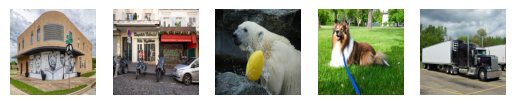

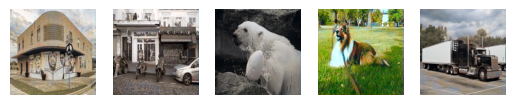

validation Output: 


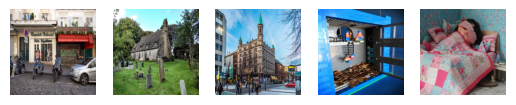

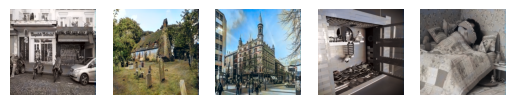


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2490.pth.
Train Epoch: 2491 [0/256 (0%)]	GanLoss: 0.332872	UNetLoss: 0.443468
Train Epoch: 2492 [0/256 (0%)]	GanLoss: 0.333240	UNetLoss: 0.428490
Train Epoch: 2493 [0/256 (0%)]	GanLoss: 0.333283	UNetLoss: 0.435583
Train Epoch: 2494 [0/256 (0%)]	GanLoss: 0.333357	UNetLoss: 0.436816
Train Epoch: 2495 [0/256 (0%)]	GanLoss: 0.333410	UNetLoss: 0.419966
Train Epoch: 2496 [0/256 (0%)]	GanLoss: 0.332993	UNetLoss: 0.444521
Train Epoch: 2497 [0/256 (0%)]	GanLoss: 0.332969	UNetLoss: 0.441284
Train Epoch: 2498 [0/256 (0%)]	GanLoss: 0.332874	UNetLoss: 0.437295
Train Epoch: 2499 [0/256 (0%)]	GanLoss: 0.332796	UNetLoss: 0.422871
Train Epoch: 2500 [0/256 (0%)]	GanLoss: 0.332986	UNetLoss: 0.445462
Training Output: 


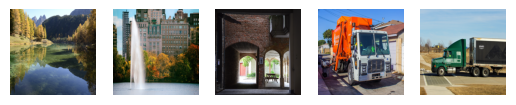

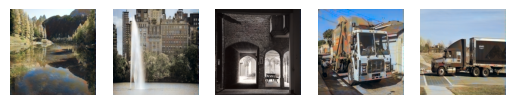

validation Output: 


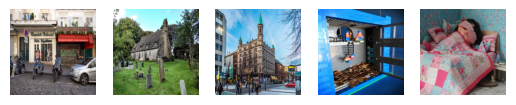

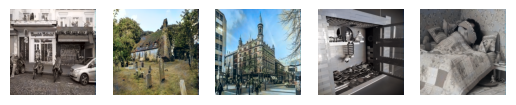


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2500.pth.
Train Epoch: 2501 [0/256 (0%)]	GanLoss: 0.332908	UNetLoss: 0.438172
Train Epoch: 2502 [0/256 (0%)]	GanLoss: 0.333037	UNetLoss: 0.425346
Train Epoch: 2503 [0/256 (0%)]	GanLoss: 0.333366	UNetLoss: 0.429294
Train Epoch: 2504 [0/256 (0%)]	GanLoss: 0.332857	UNetLoss: 0.434216
Train Epoch: 2505 [0/256 (0%)]	GanLoss: 0.332851	UNetLoss: 0.441335
Train Epoch: 2506 [0/256 (0%)]	GanLoss: 0.332509	UNetLoss: 0.434256
Train Epoch: 2507 [0/256 (0%)]	GanLoss: 0.332320	UNetLoss: 0.437760
Train Epoch: 2508 [0/256 (0%)]	GanLoss: 0.332790	UNetLoss: 0.445076
Train Epoch: 2509 [0/256 (0%)]	GanLoss: 0.332534	UNetLoss: 0.422158
Train Epoch: 2510 [0/256 (0%)]	GanLoss: 0.332373	UNetLoss: 0.433415
Training Output: 


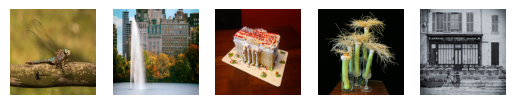

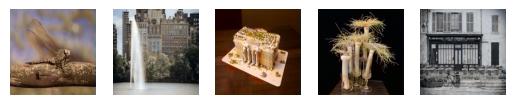

validation Output: 


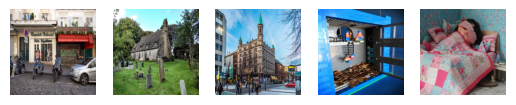

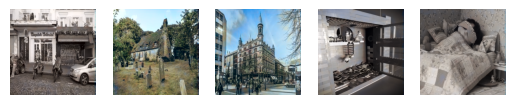


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2510.pth.
Train Epoch: 2511 [0/256 (0%)]	GanLoss: 0.332269	UNetLoss: 0.430015
Train Epoch: 2512 [0/256 (0%)]	GanLoss: 0.332255	UNetLoss: 0.413880
Train Epoch: 2513 [0/256 (0%)]	GanLoss: 0.332264	UNetLoss: 0.425144
Train Epoch: 2514 [0/256 (0%)]	GanLoss: 0.333153	UNetLoss: 0.431067
Train Epoch: 2515 [0/256 (0%)]	GanLoss: 0.332411	UNetLoss: 0.430695
Train Epoch: 2516 [0/256 (0%)]	GanLoss: 0.332196	UNetLoss: 0.421373
Train Epoch: 2517 [0/256 (0%)]	GanLoss: 0.332295	UNetLoss: 0.418531
Train Epoch: 2518 [0/256 (0%)]	GanLoss: 0.331982	UNetLoss: 0.429959
Train Epoch: 2519 [0/256 (0%)]	GanLoss: 0.332013	UNetLoss: 0.425566
Train Epoch: 2520 [0/256 (0%)]	GanLoss: 0.331883	UNetLoss: 0.433452
Training Output: 


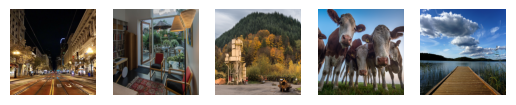

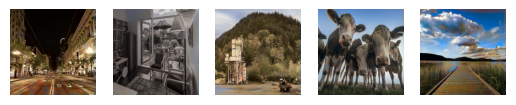

validation Output: 


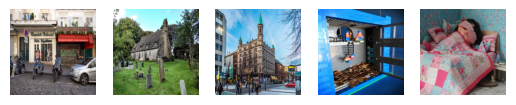

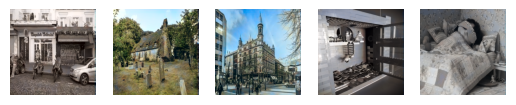


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2520.pth.
Train Epoch: 2521 [0/256 (0%)]	GanLoss: 0.331787	UNetLoss: 0.433947
Train Epoch: 2522 [0/256 (0%)]	GanLoss: 0.332563	UNetLoss: 0.427149
Train Epoch: 2523 [0/256 (0%)]	GanLoss: 0.332138	UNetLoss: 0.438774
Train Epoch: 2524 [0/256 (0%)]	GanLoss: 0.332342	UNetLoss: 0.420856
Train Epoch: 2525 [0/256 (0%)]	GanLoss: 0.332018	UNetLoss: 0.415654
Train Epoch: 2526 [0/256 (0%)]	GanLoss: 0.331751	UNetLoss: 0.443009
Train Epoch: 2527 [0/256 (0%)]	GanLoss: 0.332322	UNetLoss: 0.437153
Train Epoch: 2528 [0/256 (0%)]	GanLoss: 0.331662	UNetLoss: 0.427553
Train Epoch: 2529 [0/256 (0%)]	GanLoss: 0.332216	UNetLoss: 0.426255
Train Epoch: 2530 [0/256 (0%)]	GanLoss: 0.331309	UNetLoss: 0.424071
Training Output: 


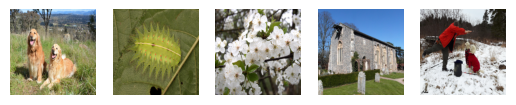

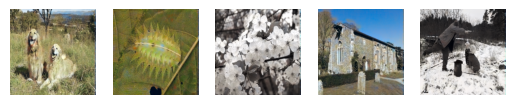

validation Output: 


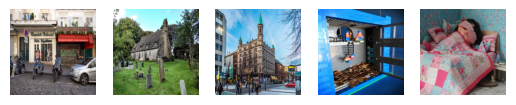

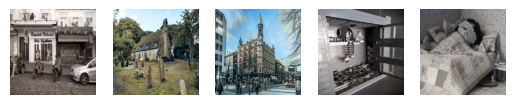


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2530.pth.
Train Epoch: 2531 [0/256 (0%)]	GanLoss: 0.331584	UNetLoss: 0.441697
Train Epoch: 2532 [0/256 (0%)]	GanLoss: 0.331587	UNetLoss: 0.425991
Train Epoch: 2533 [0/256 (0%)]	GanLoss: 0.331634	UNetLoss: 0.436954
Train Epoch: 2534 [0/256 (0%)]	GanLoss: 0.331574	UNetLoss: 0.430629
Train Epoch: 2535 [0/256 (0%)]	GanLoss: 0.331111	UNetLoss: 0.426983
Train Epoch: 2536 [0/256 (0%)]	GanLoss: 0.331716	UNetLoss: 0.438730
Train Epoch: 2537 [0/256 (0%)]	GanLoss: 0.331230	UNetLoss: 0.416929
Train Epoch: 2538 [0/256 (0%)]	GanLoss: 0.331107	UNetLoss: 0.424443
Train Epoch: 2539 [0/256 (0%)]	GanLoss: 0.331611	UNetLoss: 0.435048
Train Epoch: 2540 [0/256 (0%)]	GanLoss: 0.331487	UNetLoss: 0.436754
Training Output: 


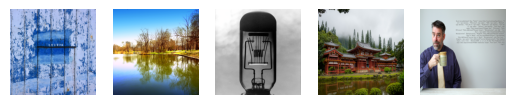

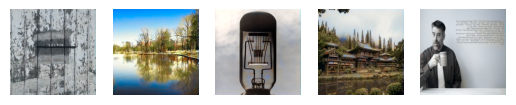

validation Output: 


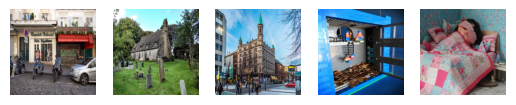

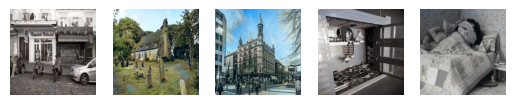


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2540.pth.
Train Epoch: 2541 [0/256 (0%)]	GanLoss: 0.331271	UNetLoss: 0.431145
Train Epoch: 2542 [0/256 (0%)]	GanLoss: 0.331041	UNetLoss: 0.431354
Train Epoch: 2543 [0/256 (0%)]	GanLoss: 0.331402	UNetLoss: 0.434760
Train Epoch: 2544 [0/256 (0%)]	GanLoss: 0.331860	UNetLoss: 0.434096
Train Epoch: 2545 [0/256 (0%)]	GanLoss: 0.330808	UNetLoss: 0.420608
Train Epoch: 2546 [0/256 (0%)]	GanLoss: 0.331114	UNetLoss: 0.434216
Train Epoch: 2547 [0/256 (0%)]	GanLoss: 0.330716	UNetLoss: 0.419806
Train Epoch: 2548 [0/256 (0%)]	GanLoss: 0.330971	UNetLoss: 0.425892
Train Epoch: 2549 [0/256 (0%)]	GanLoss: 0.330616	UNetLoss: 0.429117
Train Epoch: 2550 [0/256 (0%)]	GanLoss: 0.331079	UNetLoss: 0.431809
Training Output: 


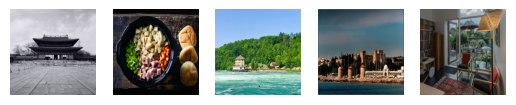

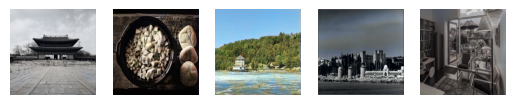

validation Output: 


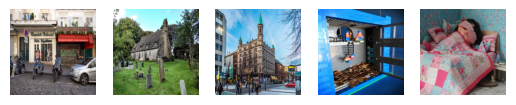

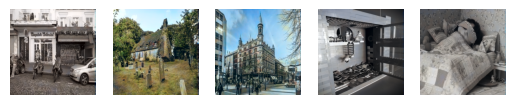


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2550.pth.
Train Epoch: 2551 [0/256 (0%)]	GanLoss: 0.330607	UNetLoss: 0.421552
Train Epoch: 2552 [0/256 (0%)]	GanLoss: 0.330580	UNetLoss: 0.426936
Train Epoch: 2553 [0/256 (0%)]	GanLoss: 0.330673	UNetLoss: 0.428754
Train Epoch: 2554 [0/256 (0%)]	GanLoss: 0.330481	UNetLoss: 0.428320
Train Epoch: 2555 [0/256 (0%)]	GanLoss: 0.331378	UNetLoss: 0.426945
Train Epoch: 2556 [0/256 (0%)]	GanLoss: 0.330238	UNetLoss: 0.435051
Train Epoch: 2557 [0/256 (0%)]	GanLoss: 0.330642	UNetLoss: 0.433728
Train Epoch: 2558 [0/256 (0%)]	GanLoss: 0.330807	UNetLoss: 0.428471
Train Epoch: 2559 [0/256 (0%)]	GanLoss: 0.330634	UNetLoss: 0.432308
Train Epoch: 2560 [0/256 (0%)]	GanLoss: 0.330494	UNetLoss: 0.428498
Training Output: 


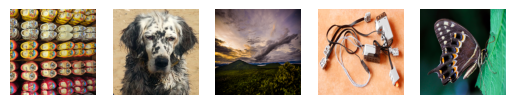

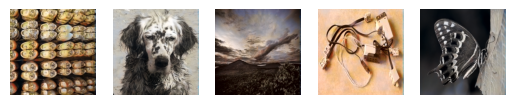

validation Output: 


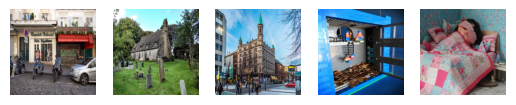

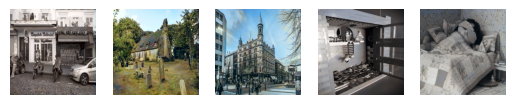


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2560.pth.
Train Epoch: 2561 [0/256 (0%)]	GanLoss: 0.330015	UNetLoss: 0.420565
Train Epoch: 2562 [0/256 (0%)]	GanLoss: 0.330201	UNetLoss: 0.422649
Train Epoch: 2563 [0/256 (0%)]	GanLoss: 0.330859	UNetLoss: 0.442179
Train Epoch: 2564 [0/256 (0%)]	GanLoss: 0.330042	UNetLoss: 0.446772
Train Epoch: 2565 [0/256 (0%)]	GanLoss: 0.330189	UNetLoss: 0.440074
Train Epoch: 2566 [0/256 (0%)]	GanLoss: 0.330187	UNetLoss: 0.433128
Train Epoch: 2567 [0/256 (0%)]	GanLoss: 0.329870	UNetLoss: 0.420708
Train Epoch: 2568 [0/256 (0%)]	GanLoss: 0.330038	UNetLoss: 0.425392
Train Epoch: 2569 [0/256 (0%)]	GanLoss: 0.329742	UNetLoss: 0.425669
Train Epoch: 2570 [0/256 (0%)]	GanLoss: 0.330239	UNetLoss: 0.425283
Training Output: 


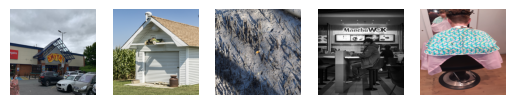

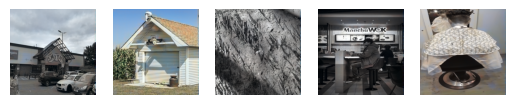

validation Output: 


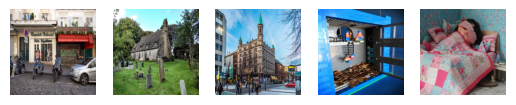

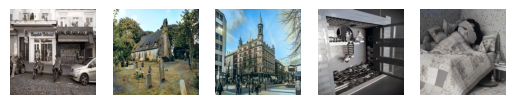


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2570.pth.
Train Epoch: 2571 [0/256 (0%)]	GanLoss: 0.329804	UNetLoss: 0.442669
Train Epoch: 2572 [0/256 (0%)]	GanLoss: 0.330004	UNetLoss: 0.420383
Train Epoch: 2573 [0/256 (0%)]	GanLoss: 0.329735	UNetLoss: 0.425863
Train Epoch: 2574 [0/256 (0%)]	GanLoss: 0.329589	UNetLoss: 0.423185
Train Epoch: 2575 [0/256 (0%)]	GanLoss: 0.330197	UNetLoss: 0.428107
Train Epoch: 2576 [0/256 (0%)]	GanLoss: 0.330535	UNetLoss: 0.426816
Train Epoch: 2577 [0/256 (0%)]	GanLoss: 0.330194	UNetLoss: 0.425337
Train Epoch: 2578 [0/256 (0%)]	GanLoss: 0.329888	UNetLoss: 0.412823
Train Epoch: 2579 [0/256 (0%)]	GanLoss: 0.329393	UNetLoss: 0.437137
Train Epoch: 2580 [0/256 (0%)]	GanLoss: 0.330248	UNetLoss: 0.428921
Training Output: 


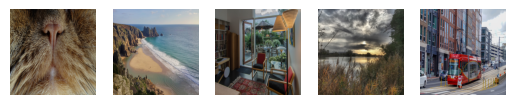

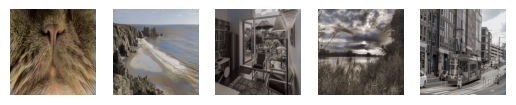

validation Output: 


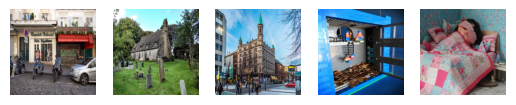

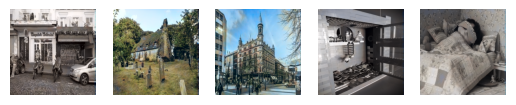


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2580.pth.
Train Epoch: 2581 [0/256 (0%)]	GanLoss: 0.329458	UNetLoss: 0.414272
Train Epoch: 2582 [0/256 (0%)]	GanLoss: 0.329632	UNetLoss: 0.426060
Train Epoch: 2583 [0/256 (0%)]	GanLoss: 0.329438	UNetLoss: 0.424046
Train Epoch: 2584 [0/256 (0%)]	GanLoss: 0.328898	UNetLoss: 0.413441
Train Epoch: 2585 [0/256 (0%)]	GanLoss: 0.329386	UNetLoss: 0.427474
Train Epoch: 2586 [0/256 (0%)]	GanLoss: 0.328935	UNetLoss: 0.425621
Train Epoch: 2587 [0/256 (0%)]	GanLoss: 0.328978	UNetLoss: 0.437187
Train Epoch: 2588 [0/256 (0%)]	GanLoss: 0.329344	UNetLoss: 0.437147
Train Epoch: 2589 [0/256 (0%)]	GanLoss: 0.328994	UNetLoss: 0.432739
Train Epoch: 2590 [0/256 (0%)]	GanLoss: 0.328875	UNetLoss: 0.433405
Training Output: 


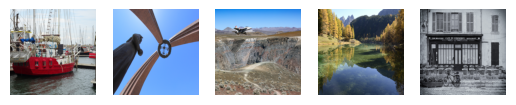

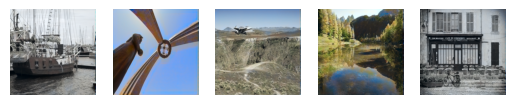

validation Output: 


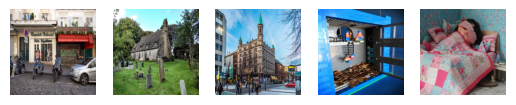

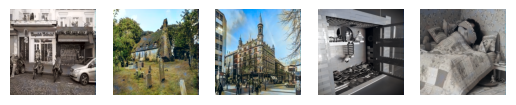


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2590.pth.
Train Epoch: 2591 [0/256 (0%)]	GanLoss: 0.329225	UNetLoss: 0.413714
Train Epoch: 2592 [0/256 (0%)]	GanLoss: 0.329014	UNetLoss: 0.438407
Train Epoch: 2593 [0/256 (0%)]	GanLoss: 0.329006	UNetLoss: 0.416903
Train Epoch: 2594 [0/256 (0%)]	GanLoss: 0.328935	UNetLoss: 0.416181
Train Epoch: 2595 [0/256 (0%)]	GanLoss: 0.329275	UNetLoss: 0.441483
Train Epoch: 2596 [0/256 (0%)]	GanLoss: 0.329115	UNetLoss: 0.438138
Train Epoch: 2597 [0/256 (0%)]	GanLoss: 0.328921	UNetLoss: 0.429408
Train Epoch: 2598 [0/256 (0%)]	GanLoss: 0.328792	UNetLoss: 0.425736
Train Epoch: 2599 [0/256 (0%)]	GanLoss: 0.328359	UNetLoss: 0.412225
Train Epoch: 2600 [0/256 (0%)]	GanLoss: 0.328832	UNetLoss: 0.431952
Training Output: 


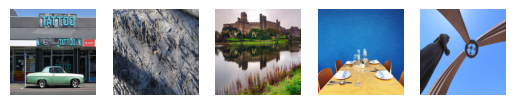

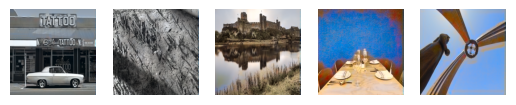

validation Output: 


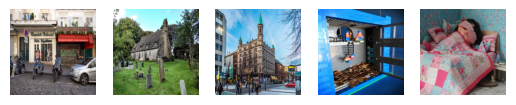

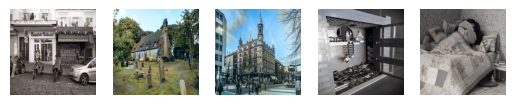


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2600.pth.
Train Epoch: 2601 [0/256 (0%)]	GanLoss: 0.328494	UNetLoss: 0.426690
Train Epoch: 2602 [0/256 (0%)]	GanLoss: 0.328779	UNetLoss: 0.426420
Train Epoch: 2603 [0/256 (0%)]	GanLoss: 0.328441	UNetLoss: 0.416487
Train Epoch: 2604 [0/256 (0%)]	GanLoss: 0.328984	UNetLoss: 0.429158
Train Epoch: 2605 [0/256 (0%)]	GanLoss: 0.328285	UNetLoss: 0.421405
Train Epoch: 2606 [0/256 (0%)]	GanLoss: 0.328386	UNetLoss: 0.431001
Train Epoch: 2607 [0/256 (0%)]	GanLoss: 0.328213	UNetLoss: 0.444440
Train Epoch: 2608 [0/256 (0%)]	GanLoss: 0.328169	UNetLoss: 0.428002
Train Epoch: 2609 [0/256 (0%)]	GanLoss: 0.328101	UNetLoss: 0.437598
Train Epoch: 2610 [0/256 (0%)]	GanLoss: 0.328334	UNetLoss: 0.418281
Training Output: 


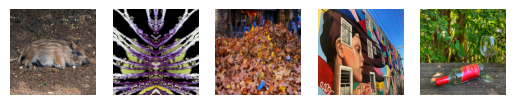

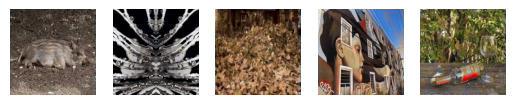

validation Output: 


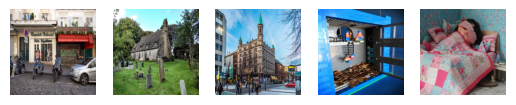

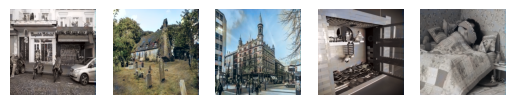


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2610.pth.
Train Epoch: 2611 [0/256 (0%)]	GanLoss: 0.328777	UNetLoss: 0.430184
Train Epoch: 2612 [0/256 (0%)]	GanLoss: 0.328403	UNetLoss: 0.423558
Train Epoch: 2613 [0/256 (0%)]	GanLoss: 0.328206	UNetLoss: 0.438859
Train Epoch: 2614 [0/256 (0%)]	GanLoss: 0.327890	UNetLoss: 0.430037
Train Epoch: 2615 [0/256 (0%)]	GanLoss: 0.327910	UNetLoss: 0.435495
Train Epoch: 2616 [0/256 (0%)]	GanLoss: 0.327834	UNetLoss: 0.423543
Train Epoch: 2617 [0/256 (0%)]	GanLoss: 0.328140	UNetLoss: 0.418643
Train Epoch: 2618 [0/256 (0%)]	GanLoss: 0.327555	UNetLoss: 0.422133
Train Epoch: 2619 [0/256 (0%)]	GanLoss: 0.327862	UNetLoss: 0.432476
Train Epoch: 2620 [0/256 (0%)]	GanLoss: 0.327713	UNetLoss: 0.430587
Training Output: 


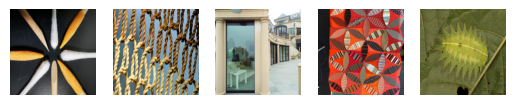

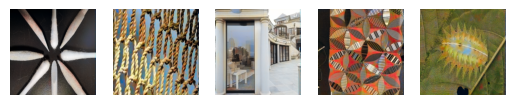

validation Output: 


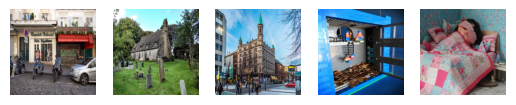

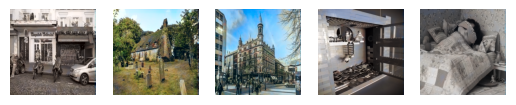


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2620.pth.
Train Epoch: 2621 [0/256 (0%)]	GanLoss: 0.327658	UNetLoss: 0.425310
Train Epoch: 2622 [0/256 (0%)]	GanLoss: 0.327868	UNetLoss: 0.412945
Train Epoch: 2623 [0/256 (0%)]	GanLoss: 0.327886	UNetLoss: 0.428501
Train Epoch: 2624 [0/256 (0%)]	GanLoss: 0.327461	UNetLoss: 0.419396
Train Epoch: 2625 [0/256 (0%)]	GanLoss: 0.327852	UNetLoss: 0.435143
Train Epoch: 2626 [0/256 (0%)]	GanLoss: 0.327389	UNetLoss: 0.445667
Train Epoch: 2627 [0/256 (0%)]	GanLoss: 0.327442	UNetLoss: 0.431225
Train Epoch: 2628 [0/256 (0%)]	GanLoss: 0.327540	UNetLoss: 0.425656
Train Epoch: 2629 [0/256 (0%)]	GanLoss: 0.327572	UNetLoss: 0.417943
Train Epoch: 2630 [0/256 (0%)]	GanLoss: 0.328158	UNetLoss: 0.447326
Training Output: 


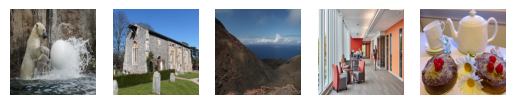

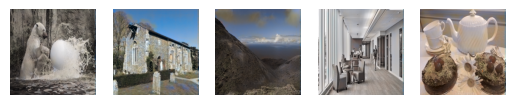

validation Output: 


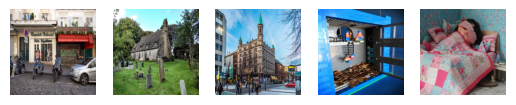

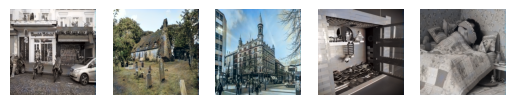


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2630.pth.
Train Epoch: 2631 [0/256 (0%)]	GanLoss: 0.327424	UNetLoss: 0.428603
Train Epoch: 2632 [0/256 (0%)]	GanLoss: 0.327370	UNetLoss: 0.428935
Train Epoch: 2633 [0/256 (0%)]	GanLoss: 0.327208	UNetLoss: 0.419554
Train Epoch: 2634 [0/256 (0%)]	GanLoss: 0.327237	UNetLoss: 0.419110
Train Epoch: 2635 [0/256 (0%)]	GanLoss: 0.326965	UNetLoss: 0.417486
Train Epoch: 2636 [0/256 (0%)]	GanLoss: 0.327167	UNetLoss: 0.433104
Train Epoch: 2637 [0/256 (0%)]	GanLoss: 0.326934	UNetLoss: 0.427805
Train Epoch: 2638 [0/256 (0%)]	GanLoss: 0.326995	UNetLoss: 0.426147
Train Epoch: 2639 [0/256 (0%)]	GanLoss: 0.327403	UNetLoss: 0.430585
Train Epoch: 2640 [0/256 (0%)]	GanLoss: 0.326549	UNetLoss: 0.425600
Training Output: 


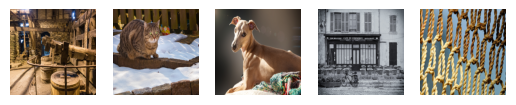

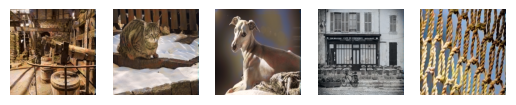

validation Output: 


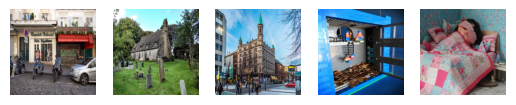

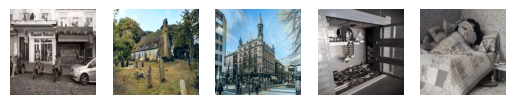


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2640.pth.
Train Epoch: 2641 [0/256 (0%)]	GanLoss: 0.326459	UNetLoss: 0.432268
Train Epoch: 2642 [0/256 (0%)]	GanLoss: 0.326825	UNetLoss: 0.435997
Train Epoch: 2643 [0/256 (0%)]	GanLoss: 0.326594	UNetLoss: 0.419500
Train Epoch: 2644 [0/256 (0%)]	GanLoss: 0.326665	UNetLoss: 0.421403
Train Epoch: 2645 [0/256 (0%)]	GanLoss: 0.326381	UNetLoss: 0.414889
Train Epoch: 2646 [0/256 (0%)]	GanLoss: 0.326746	UNetLoss: 0.431948
Train Epoch: 2647 [0/256 (0%)]	GanLoss: 0.326832	UNetLoss: 0.416943
Train Epoch: 2648 [0/256 (0%)]	GanLoss: 0.326443	UNetLoss: 0.432979
Train Epoch: 2649 [0/256 (0%)]	GanLoss: 0.326918	UNetLoss: 0.436937
Train Epoch: 2650 [0/256 (0%)]	GanLoss: 0.326358	UNetLoss: 0.428080
Training Output: 


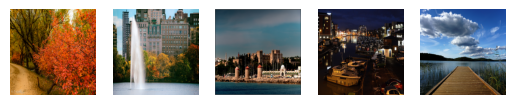

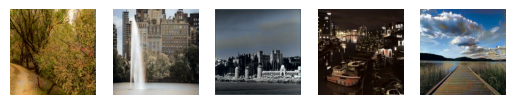

validation Output: 


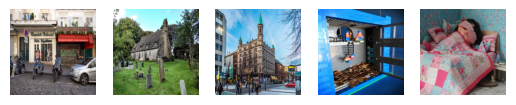

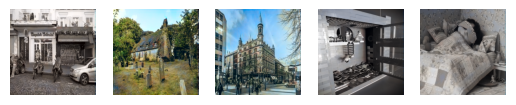


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2650.pth.
Train Epoch: 2651 [0/256 (0%)]	GanLoss: 0.326462	UNetLoss: 0.425804
Train Epoch: 2652 [0/256 (0%)]	GanLoss: 0.326779	UNetLoss: 0.424200
Train Epoch: 2653 [0/256 (0%)]	GanLoss: 0.326426	UNetLoss: 0.444420
Train Epoch: 2654 [0/256 (0%)]	GanLoss: 0.326838	UNetLoss: 0.442873
Train Epoch: 2655 [0/256 (0%)]	GanLoss: 0.326720	UNetLoss: 0.428567
Train Epoch: 2656 [0/256 (0%)]	GanLoss: 0.326757	UNetLoss: 0.432172
Train Epoch: 2657 [0/256 (0%)]	GanLoss: 0.327099	UNetLoss: 0.433316
Train Epoch: 2658 [0/256 (0%)]	GanLoss: 0.326709	UNetLoss: 0.423178
Train Epoch: 2659 [0/256 (0%)]	GanLoss: 0.326362	UNetLoss: 0.420475
Train Epoch: 2660 [0/256 (0%)]	GanLoss: 0.326111	UNetLoss: 0.424714
Training Output: 


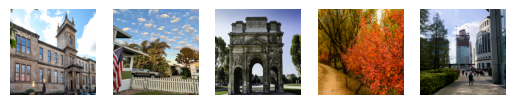

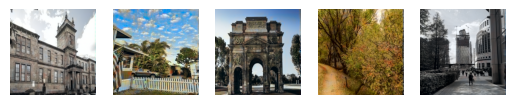

validation Output: 


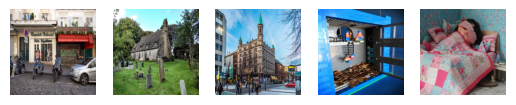

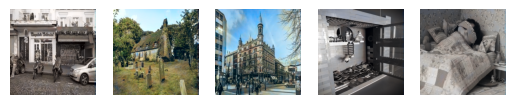


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2660.pth.
Train Epoch: 2661 [0/256 (0%)]	GanLoss: 0.325831	UNetLoss: 0.424859
Train Epoch: 2662 [0/256 (0%)]	GanLoss: 0.325819	UNetLoss: 0.414533
Train Epoch: 2663 [0/256 (0%)]	GanLoss: 0.326005	UNetLoss: 0.431925
Train Epoch: 2664 [0/256 (0%)]	GanLoss: 0.326091	UNetLoss: 0.435831
Train Epoch: 2665 [0/256 (0%)]	GanLoss: 0.325741	UNetLoss: 0.415359
Train Epoch: 2666 [0/256 (0%)]	GanLoss: 0.325726	UNetLoss: 0.435112
Train Epoch: 2667 [0/256 (0%)]	GanLoss: 0.325845	UNetLoss: 0.431005
Train Epoch: 2668 [0/256 (0%)]	GanLoss: 0.325542	UNetLoss: 0.408113
Train Epoch: 2669 [0/256 (0%)]	GanLoss: 0.326082	UNetLoss: 0.428605
Train Epoch: 2670 [0/256 (0%)]	GanLoss: 0.325421	UNetLoss: 0.423061
Training Output: 


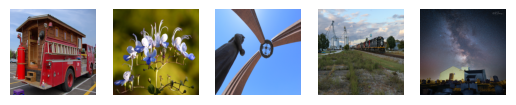

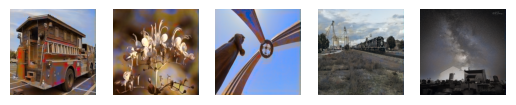

validation Output: 


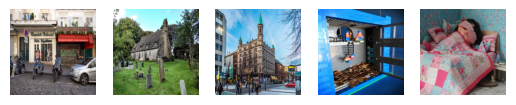

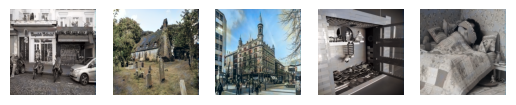


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2670.pth.
Train Epoch: 2671 [0/256 (0%)]	GanLoss: 0.325282	UNetLoss: 0.431588
Train Epoch: 2672 [0/256 (0%)]	GanLoss: 0.325602	UNetLoss: 0.423094
Train Epoch: 2673 [0/256 (0%)]	GanLoss: 0.325456	UNetLoss: 0.427157
Train Epoch: 2674 [0/256 (0%)]	GanLoss: 0.325393	UNetLoss: 0.417050
Train Epoch: 2675 [0/256 (0%)]	GanLoss: 0.325534	UNetLoss: 0.426428
Train Epoch: 2676 [0/256 (0%)]	GanLoss: 0.325621	UNetLoss: 0.426704
Train Epoch: 2677 [0/256 (0%)]	GanLoss: 0.325786	UNetLoss: 0.432289
Train Epoch: 2678 [0/256 (0%)]	GanLoss: 0.325294	UNetLoss: 0.434292
Train Epoch: 2679 [0/256 (0%)]	GanLoss: 0.325183	UNetLoss: 0.424233
Train Epoch: 2680 [0/256 (0%)]	GanLoss: 0.325481	UNetLoss: 0.427037
Training Output: 


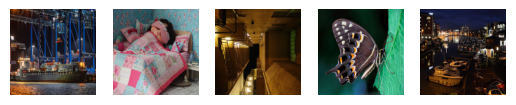

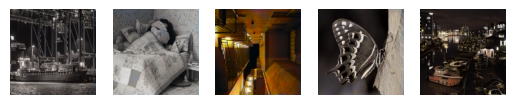

validation Output: 


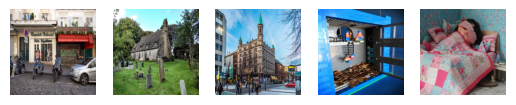

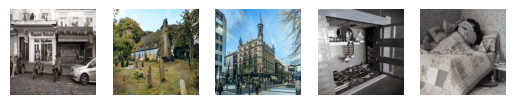


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2680.pth.
Train Epoch: 2681 [0/256 (0%)]	GanLoss: 0.325606	UNetLoss: 0.414524
Train Epoch: 2682 [0/256 (0%)]	GanLoss: 0.325051	UNetLoss: 0.425800
Train Epoch: 2683 [0/256 (0%)]	GanLoss: 0.325084	UNetLoss: 0.425685
Train Epoch: 2684 [0/256 (0%)]	GanLoss: 0.325530	UNetLoss: 0.425646
Train Epoch: 2685 [0/256 (0%)]	GanLoss: 0.324755	UNetLoss: 0.427166
Train Epoch: 2686 [0/256 (0%)]	GanLoss: 0.324938	UNetLoss: 0.415887
Train Epoch: 2687 [0/256 (0%)]	GanLoss: 0.325550	UNetLoss: 0.417409
Train Epoch: 2688 [0/256 (0%)]	GanLoss: 0.325110	UNetLoss: 0.416973
Train Epoch: 2689 [0/256 (0%)]	GanLoss: 0.325159	UNetLoss: 0.424660
Train Epoch: 2690 [0/256 (0%)]	GanLoss: 0.325188	UNetLoss: 0.417195
Training Output: 


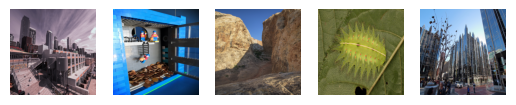

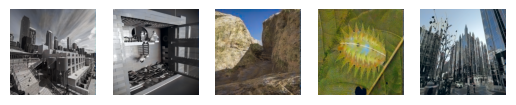

validation Output: 


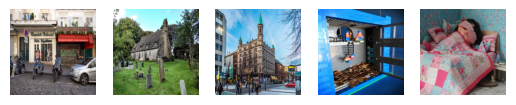

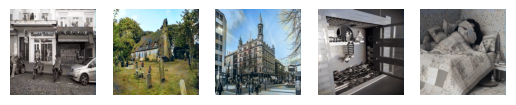


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2690.pth.
Train Epoch: 2691 [0/256 (0%)]	GanLoss: 0.325024	UNetLoss: 0.421176
Train Epoch: 2692 [0/256 (0%)]	GanLoss: 0.324520	UNetLoss: 0.426866
Train Epoch: 2693 [0/256 (0%)]	GanLoss: 0.324659	UNetLoss: 0.443798
Train Epoch: 2694 [0/256 (0%)]	GanLoss: 0.324766	UNetLoss: 0.406872
Train Epoch: 2695 [0/256 (0%)]	GanLoss: 0.324948	UNetLoss: 0.420415
Train Epoch: 2696 [0/256 (0%)]	GanLoss: 0.324772	UNetLoss: 0.419186
Train Epoch: 2697 [0/256 (0%)]	GanLoss: 0.324211	UNetLoss: 0.416613
Train Epoch: 2698 [0/256 (0%)]	GanLoss: 0.324439	UNetLoss: 0.416465
Train Epoch: 2699 [0/256 (0%)]	GanLoss: 0.324571	UNetLoss: 0.426726
Train Epoch: 2700 [0/256 (0%)]	GanLoss: 0.324041	UNetLoss: 0.427539
Training Output: 


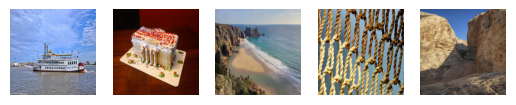

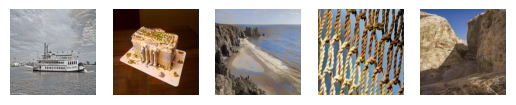

validation Output: 


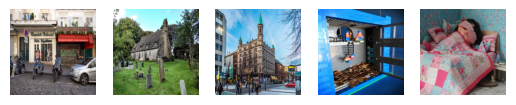

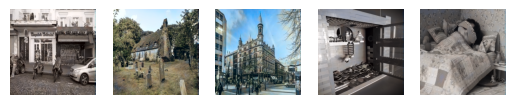


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2700.pth.
Train Epoch: 2701 [0/256 (0%)]	GanLoss: 0.324254	UNetLoss: 0.421729
Train Epoch: 2702 [0/256 (0%)]	GanLoss: 0.324128	UNetLoss: 0.430779
Train Epoch: 2703 [0/256 (0%)]	GanLoss: 0.324389	UNetLoss: 0.416535
Train Epoch: 2704 [0/256 (0%)]	GanLoss: 0.324433	UNetLoss: 0.420046
Train Epoch: 2705 [0/256 (0%)]	GanLoss: 0.324128	UNetLoss: 0.420172
Train Epoch: 2706 [0/256 (0%)]	GanLoss: 0.323998	UNetLoss: 0.426247
Train Epoch: 2707 [0/256 (0%)]	GanLoss: 0.323636	UNetLoss: 0.411887
Train Epoch: 2708 [0/256 (0%)]	GanLoss: 0.323933	UNetLoss: 0.415212
Train Epoch: 2709 [0/256 (0%)]	GanLoss: 0.324018	UNetLoss: 0.409945
Train Epoch: 2710 [0/256 (0%)]	GanLoss: 0.323738	UNetLoss: 0.429139
Training Output: 


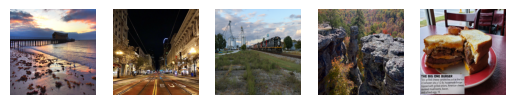

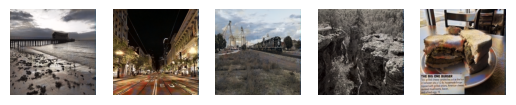

validation Output: 


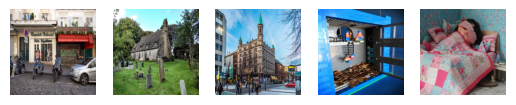

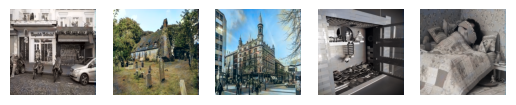


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2710.pth.
Train Epoch: 2711 [0/256 (0%)]	GanLoss: 0.323928	UNetLoss: 0.423550
Train Epoch: 2712 [0/256 (0%)]	GanLoss: 0.323952	UNetLoss: 0.420052
Train Epoch: 2713 [0/256 (0%)]	GanLoss: 0.324291	UNetLoss: 0.418889
Train Epoch: 2714 [0/256 (0%)]	GanLoss: 0.324329	UNetLoss: 0.421124
Train Epoch: 2715 [0/256 (0%)]	GanLoss: 0.323672	UNetLoss: 0.416926
Train Epoch: 2716 [0/256 (0%)]	GanLoss: 0.323900	UNetLoss: 0.418375
Train Epoch: 2717 [0/256 (0%)]	GanLoss: 0.323811	UNetLoss: 0.409106
Train Epoch: 2718 [0/256 (0%)]	GanLoss: 0.323227	UNetLoss: 0.434467
Train Epoch: 2719 [0/256 (0%)]	GanLoss: 0.324051	UNetLoss: 0.417559
Train Epoch: 2720 [0/256 (0%)]	GanLoss: 0.323153	UNetLoss: 0.417148
Training Output: 


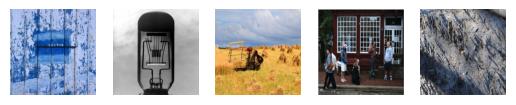

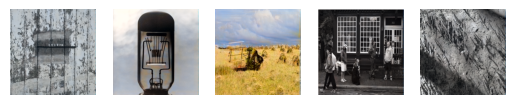

validation Output: 


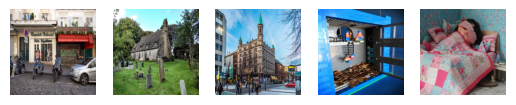

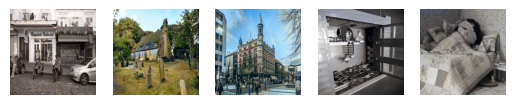


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2720.pth.
Train Epoch: 2721 [0/256 (0%)]	GanLoss: 0.323429	UNetLoss: 0.426370
Train Epoch: 2722 [0/256 (0%)]	GanLoss: 0.323846	UNetLoss: 0.420183
Train Epoch: 2723 [0/256 (0%)]	GanLoss: 0.323799	UNetLoss: 0.426352
Train Epoch: 2724 [0/256 (0%)]	GanLoss: 0.323476	UNetLoss: 0.414426
Train Epoch: 2725 [0/256 (0%)]	GanLoss: 0.323142	UNetLoss: 0.417170
Train Epoch: 2726 [0/256 (0%)]	GanLoss: 0.323465	UNetLoss: 0.410259
Train Epoch: 2727 [0/256 (0%)]	GanLoss: 0.323079	UNetLoss: 0.419646
Train Epoch: 2728 [0/256 (0%)]	GanLoss: 0.323465	UNetLoss: 0.408446
Train Epoch: 2729 [0/256 (0%)]	GanLoss: 0.323443	UNetLoss: 0.420569
Train Epoch: 2730 [0/256 (0%)]	GanLoss: 0.323219	UNetLoss: 0.420584
Training Output: 


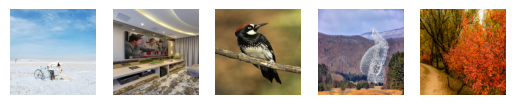

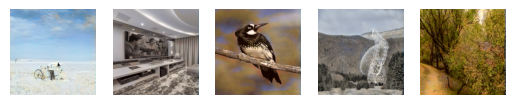

validation Output: 


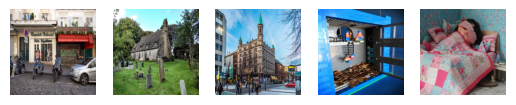

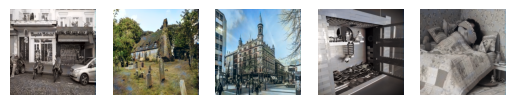


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2730.pth.
Train Epoch: 2731 [0/256 (0%)]	GanLoss: 0.322833	UNetLoss: 0.421750
Train Epoch: 2732 [0/256 (0%)]	GanLoss: 0.323528	UNetLoss: 0.416545
Train Epoch: 2733 [0/256 (0%)]	GanLoss: 0.323521	UNetLoss: 0.417307
Train Epoch: 2734 [0/256 (0%)]	GanLoss: 0.323315	UNetLoss: 0.412600
Train Epoch: 2735 [0/256 (0%)]	GanLoss: 0.322813	UNetLoss: 0.422598
Train Epoch: 2736 [0/256 (0%)]	GanLoss: 0.322992	UNetLoss: 0.415994
Train Epoch: 2737 [0/256 (0%)]	GanLoss: 0.322645	UNetLoss: 0.409615
Train Epoch: 2738 [0/256 (0%)]	GanLoss: 0.322915	UNetLoss: 0.428955
Train Epoch: 2739 [0/256 (0%)]	GanLoss: 0.322858	UNetLoss: 0.426808
Train Epoch: 2740 [0/256 (0%)]	GanLoss: 0.322835	UNetLoss: 0.420895
Training Output: 


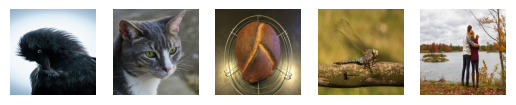

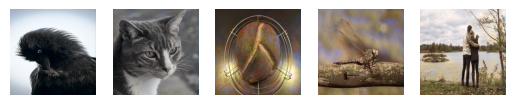

validation Output: 


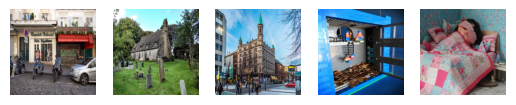

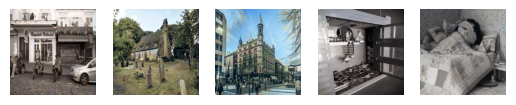


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2740.pth.
Train Epoch: 2741 [0/256 (0%)]	GanLoss: 0.323783	UNetLoss: 0.411110
Train Epoch: 2742 [0/256 (0%)]	GanLoss: 0.324154	UNetLoss: 0.416554
Train Epoch: 2743 [0/256 (0%)]	GanLoss: 0.330272	UNetLoss: 0.435407
Train Epoch: 2744 [0/256 (0%)]	GanLoss: 0.329161	UNetLoss: 0.426118
Train Epoch: 2745 [0/256 (0%)]	GanLoss: 0.327005	UNetLoss: 0.408748
Train Epoch: 2746 [0/256 (0%)]	GanLoss: 0.323445	UNetLoss: 0.441170
Train Epoch: 2747 [0/256 (0%)]	GanLoss: 0.322650	UNetLoss: 0.414536
Train Epoch: 2748 [0/256 (0%)]	GanLoss: 0.322842	UNetLoss: 0.422492
Train Epoch: 2749 [0/256 (0%)]	GanLoss: 0.322608	UNetLoss: 0.425080
Train Epoch: 2750 [0/256 (0%)]	GanLoss: 0.322536	UNetLoss: 0.413513
Training Output: 


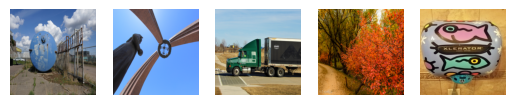

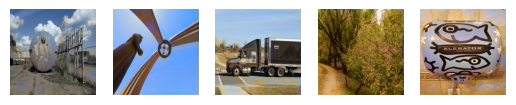

validation Output: 


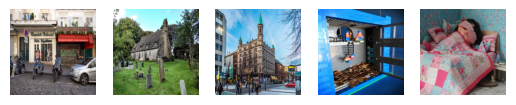

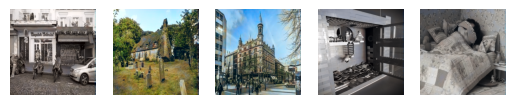


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2750.pth.
Train Epoch: 2751 [0/256 (0%)]	GanLoss: 0.322339	UNetLoss: 0.410798
Train Epoch: 2752 [0/256 (0%)]	GanLoss: 0.322478	UNetLoss: 0.415862
Train Epoch: 2753 [0/256 (0%)]	GanLoss: 0.322268	UNetLoss: 0.419145
Train Epoch: 2754 [0/256 (0%)]	GanLoss: 0.321997	UNetLoss: 0.414371
Train Epoch: 2755 [0/256 (0%)]	GanLoss: 0.322236	UNetLoss: 0.412444
Train Epoch: 2756 [0/256 (0%)]	GanLoss: 0.321963	UNetLoss: 0.416337
Train Epoch: 2757 [0/256 (0%)]	GanLoss: 0.322402	UNetLoss: 0.420784
Train Epoch: 2758 [0/256 (0%)]	GanLoss: 0.321854	UNetLoss: 0.423732
Train Epoch: 2759 [0/256 (0%)]	GanLoss: 0.322034	UNetLoss: 0.420569
Train Epoch: 2760 [0/256 (0%)]	GanLoss: 0.321624	UNetLoss: 0.413638
Training Output: 


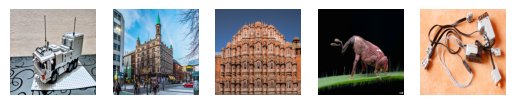

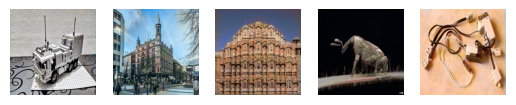

validation Output: 


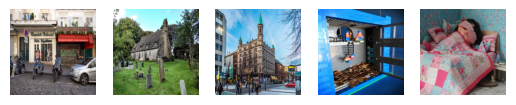

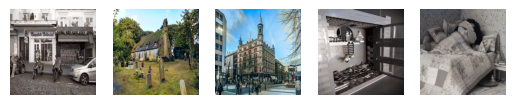


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2760.pth.
Train Epoch: 2761 [0/256 (0%)]	GanLoss: 0.321809	UNetLoss: 0.414198
Train Epoch: 2762 [0/256 (0%)]	GanLoss: 0.321961	UNetLoss: 0.413294
Train Epoch: 2763 [0/256 (0%)]	GanLoss: 0.322001	UNetLoss: 0.426126
Train Epoch: 2764 [0/256 (0%)]	GanLoss: 0.321812	UNetLoss: 0.409902
Train Epoch: 2765 [0/256 (0%)]	GanLoss: 0.321726	UNetLoss: 0.417247
Train Epoch: 2766 [0/256 (0%)]	GanLoss: 0.322183	UNetLoss: 0.424292
Train Epoch: 2767 [0/256 (0%)]	GanLoss: 0.321517	UNetLoss: 0.412595
Train Epoch: 2768 [0/256 (0%)]	GanLoss: 0.321372	UNetLoss: 0.414153
Train Epoch: 2769 [0/256 (0%)]	GanLoss: 0.321511	UNetLoss: 0.425700
Train Epoch: 2770 [0/256 (0%)]	GanLoss: 0.321168	UNetLoss: 0.430067
Training Output: 


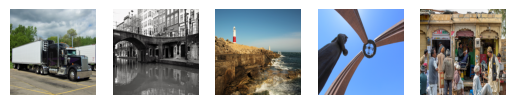

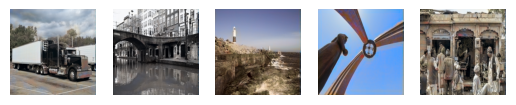

validation Output: 


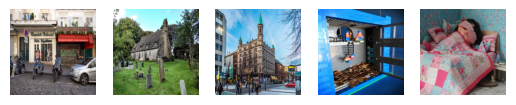

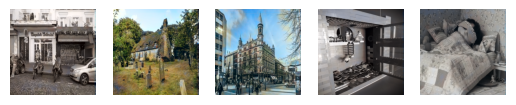


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2770.pth.
Train Epoch: 2771 [0/256 (0%)]	GanLoss: 0.321459	UNetLoss: 0.403729
Train Epoch: 2772 [0/256 (0%)]	GanLoss: 0.321304	UNetLoss: 0.419166
Train Epoch: 2773 [0/256 (0%)]	GanLoss: 0.321295	UNetLoss: 0.429559
Train Epoch: 2774 [0/256 (0%)]	GanLoss: 0.321041	UNetLoss: 0.416406
Train Epoch: 2775 [0/256 (0%)]	GanLoss: 0.321386	UNetLoss: 0.429995
Train Epoch: 2776 [0/256 (0%)]	GanLoss: 0.321341	UNetLoss: 0.406736
Train Epoch: 2777 [0/256 (0%)]	GanLoss: 0.321339	UNetLoss: 0.417220
Train Epoch: 2778 [0/256 (0%)]	GanLoss: 0.321351	UNetLoss: 0.420880
Train Epoch: 2779 [0/256 (0%)]	GanLoss: 0.321168	UNetLoss: 0.416472
Train Epoch: 2780 [0/256 (0%)]	GanLoss: 0.320948	UNetLoss: 0.412384
Training Output: 


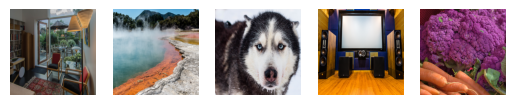

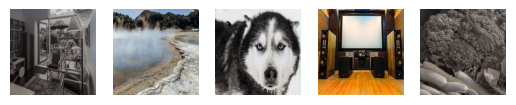

validation Output: 


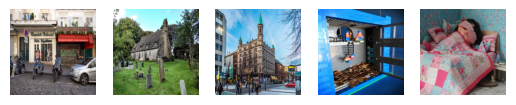

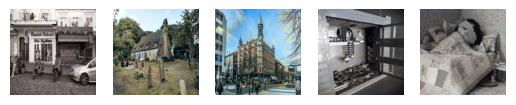


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2780.pth.
Train Epoch: 2781 [0/256 (0%)]	GanLoss: 0.320711	UNetLoss: 0.423691
Train Epoch: 2782 [0/256 (0%)]	GanLoss: 0.321075	UNetLoss: 0.413023
Train Epoch: 2783 [0/256 (0%)]	GanLoss: 0.320805	UNetLoss: 0.409245
Train Epoch: 2784 [0/256 (0%)]	GanLoss: 0.320813	UNetLoss: 0.408360
Train Epoch: 2785 [0/256 (0%)]	GanLoss: 0.320615	UNetLoss: 0.418557
Train Epoch: 2786 [0/256 (0%)]	GanLoss: 0.320810	UNetLoss: 0.421619
Train Epoch: 2787 [0/256 (0%)]	GanLoss: 0.321141	UNetLoss: 0.417712
Train Epoch: 2788 [0/256 (0%)]	GanLoss: 0.320900	UNetLoss: 0.421476
Train Epoch: 2789 [0/256 (0%)]	GanLoss: 0.320548	UNetLoss: 0.416429
Train Epoch: 2790 [0/256 (0%)]	GanLoss: 0.320616	UNetLoss: 0.411190
Training Output: 


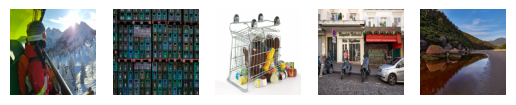

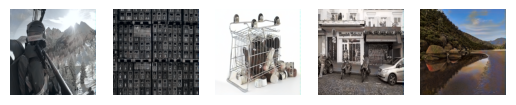

validation Output: 


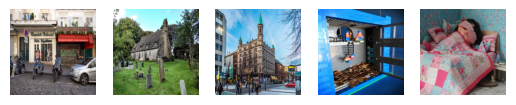

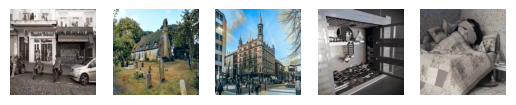


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2790.pth.
Train Epoch: 2791 [0/256 (0%)]	GanLoss: 0.320401	UNetLoss: 0.410343
Train Epoch: 2792 [0/256 (0%)]	GanLoss: 0.321214	UNetLoss: 0.410930
Train Epoch: 2793 [0/256 (0%)]	GanLoss: 0.320724	UNetLoss: 0.412163
Train Epoch: 2794 [0/256 (0%)]	GanLoss: 0.320578	UNetLoss: 0.418228
Train Epoch: 2795 [0/256 (0%)]	GanLoss: 0.320754	UNetLoss: 0.418981
Train Epoch: 2796 [0/256 (0%)]	GanLoss: 0.320189	UNetLoss: 0.413370
Train Epoch: 2797 [0/256 (0%)]	GanLoss: 0.320186	UNetLoss: 0.418815
Train Epoch: 2798 [0/256 (0%)]	GanLoss: 0.320460	UNetLoss: 0.423201
Train Epoch: 2799 [0/256 (0%)]	GanLoss: 0.320166	UNetLoss: 0.422796
Train Epoch: 2800 [0/256 (0%)]	GanLoss: 0.320344	UNetLoss: 0.409871
Training Output: 


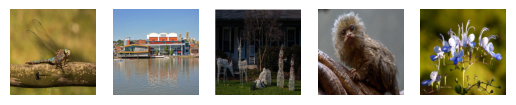

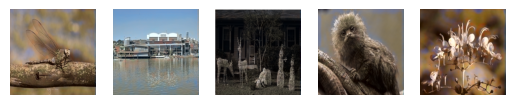

validation Output: 


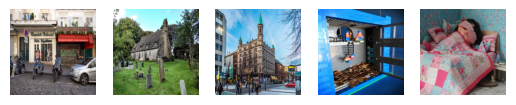

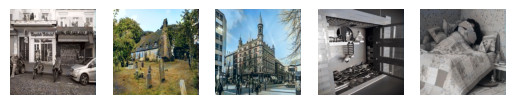


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2800.pth.
Train Epoch: 2801 [0/256 (0%)]	GanLoss: 0.320054	UNetLoss: 0.425958
Train Epoch: 2802 [0/256 (0%)]	GanLoss: 0.319803	UNetLoss: 0.426099
Train Epoch: 2803 [0/256 (0%)]	GanLoss: 0.320504	UNetLoss: 0.436711
Train Epoch: 2804 [0/256 (0%)]	GanLoss: 0.320193	UNetLoss: 0.420040
Train Epoch: 2805 [0/256 (0%)]	GanLoss: 0.320118	UNetLoss: 0.415719
Train Epoch: 2806 [0/256 (0%)]	GanLoss: 0.319964	UNetLoss: 0.416424
Train Epoch: 2807 [0/256 (0%)]	GanLoss: 0.320253	UNetLoss: 0.414705
Train Epoch: 2808 [0/256 (0%)]	GanLoss: 0.319966	UNetLoss: 0.420002
Train Epoch: 2809 [0/256 (0%)]	GanLoss: 0.319863	UNetLoss: 0.420022
Train Epoch: 2810 [0/256 (0%)]	GanLoss: 0.319829	UNetLoss: 0.423083
Training Output: 


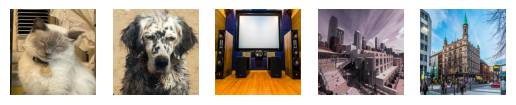

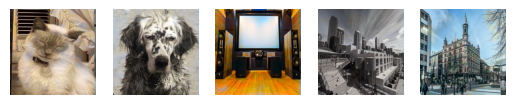

validation Output: 


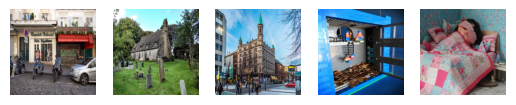

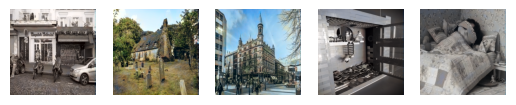


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2810.pth.
Train Epoch: 2811 [0/256 (0%)]	GanLoss: 0.320342	UNetLoss: 0.427349
Train Epoch: 2812 [0/256 (0%)]	GanLoss: 0.320004	UNetLoss: 0.434249
Train Epoch: 2813 [0/256 (0%)]	GanLoss: 0.320022	UNetLoss: 0.413440
Train Epoch: 2814 [0/256 (0%)]	GanLoss: 0.319581	UNetLoss: 0.404336
Train Epoch: 2815 [0/256 (0%)]	GanLoss: 0.319884	UNetLoss: 0.415475
Train Epoch: 2816 [0/256 (0%)]	GanLoss: 0.320089	UNetLoss: 0.421369
Train Epoch: 2817 [0/256 (0%)]	GanLoss: 0.319939	UNetLoss: 0.420620
Train Epoch: 2818 [0/256 (0%)]	GanLoss: 0.319601	UNetLoss: 0.416816
Train Epoch: 2819 [0/256 (0%)]	GanLoss: 0.319748	UNetLoss: 0.419039
Train Epoch: 2820 [0/256 (0%)]	GanLoss: 0.319292	UNetLoss: 0.435977
Training Output: 


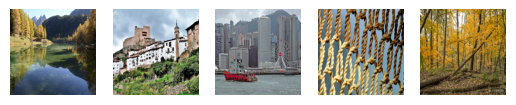

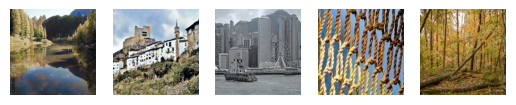

validation Output: 


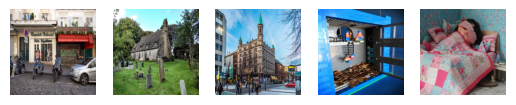

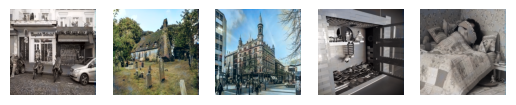


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2820.pth.
Train Epoch: 2821 [0/256 (0%)]	GanLoss: 0.319598	UNetLoss: 0.419339
Train Epoch: 2822 [0/256 (0%)]	GanLoss: 0.319166	UNetLoss: 0.412478
Train Epoch: 2823 [0/256 (0%)]	GanLoss: 0.319532	UNetLoss: 0.421486
Train Epoch: 2824 [0/256 (0%)]	GanLoss: 0.319524	UNetLoss: 0.400220
Train Epoch: 2825 [0/256 (0%)]	GanLoss: 0.319301	UNetLoss: 0.421565
Train Epoch: 2826 [0/256 (0%)]	GanLoss: 0.319247	UNetLoss: 0.416948
Train Epoch: 2827 [0/256 (0%)]	GanLoss: 0.320006	UNetLoss: 0.418005
Train Epoch: 2828 [0/256 (0%)]	GanLoss: 0.319512	UNetLoss: 0.410694
Train Epoch: 2829 [0/256 (0%)]	GanLoss: 0.319217	UNetLoss: 0.416037
Train Epoch: 2830 [0/256 (0%)]	GanLoss: 0.319027	UNetLoss: 0.414036
Training Output: 


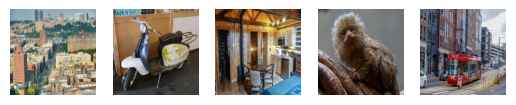

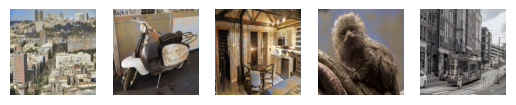

validation Output: 


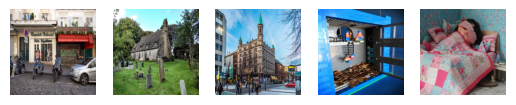

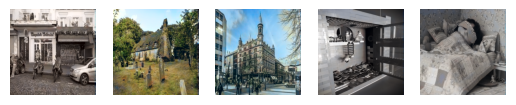


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2830.pth.
Train Epoch: 2831 [0/256 (0%)]	GanLoss: 0.319332	UNetLoss: 0.409394
Train Epoch: 2832 [0/256 (0%)]	GanLoss: 0.319138	UNetLoss: 0.408163
Train Epoch: 2833 [0/256 (0%)]	GanLoss: 0.319121	UNetLoss: 0.409721
Train Epoch: 2834 [0/256 (0%)]	GanLoss: 0.318946	UNetLoss: 0.406936
Train Epoch: 2835 [0/256 (0%)]	GanLoss: 0.318796	UNetLoss: 0.413746
Train Epoch: 2836 [0/256 (0%)]	GanLoss: 0.318761	UNetLoss: 0.403297
Train Epoch: 2837 [0/256 (0%)]	GanLoss: 0.319018	UNetLoss: 0.416109
Train Epoch: 2838 [0/256 (0%)]	GanLoss: 0.319136	UNetLoss: 0.409321
Train Epoch: 2839 [0/256 (0%)]	GanLoss: 0.318791	UNetLoss: 0.410595
Train Epoch: 2840 [0/256 (0%)]	GanLoss: 0.318745	UNetLoss: 0.412176
Training Output: 


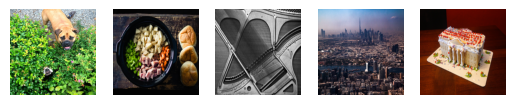

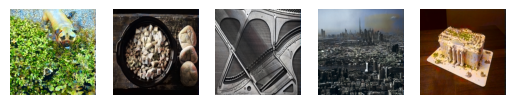

validation Output: 


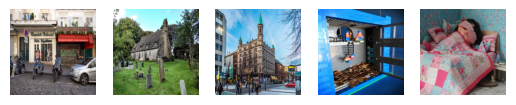

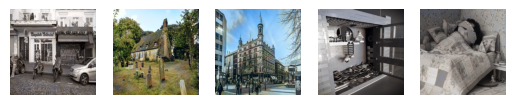


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2840.pth.
Train Epoch: 2841 [0/256 (0%)]	GanLoss: 0.318549	UNetLoss: 0.415483
Train Epoch: 2842 [0/256 (0%)]	GanLoss: 0.318561	UNetLoss: 0.404316
Train Epoch: 2843 [0/256 (0%)]	GanLoss: 0.318529	UNetLoss: 0.415082
Train Epoch: 2844 [0/256 (0%)]	GanLoss: 0.318614	UNetLoss: 0.420462
Train Epoch: 2845 [0/256 (0%)]	GanLoss: 0.318564	UNetLoss: 0.413970
Train Epoch: 2846 [0/256 (0%)]	GanLoss: 0.319420	UNetLoss: 0.416164
Train Epoch: 2847 [0/256 (0%)]	GanLoss: 0.318556	UNetLoss: 0.410626
Train Epoch: 2848 [0/256 (0%)]	GanLoss: 0.318754	UNetLoss: 0.418010
Train Epoch: 2849 [0/256 (0%)]	GanLoss: 0.318293	UNetLoss: 0.421736
Train Epoch: 2850 [0/256 (0%)]	GanLoss: 0.318423	UNetLoss: 0.422558
Training Output: 


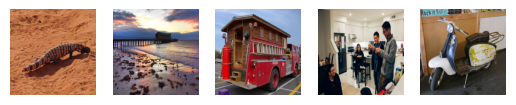

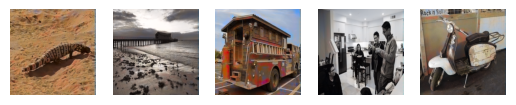

validation Output: 


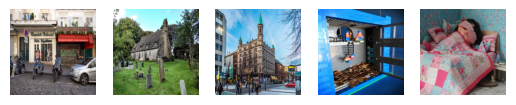

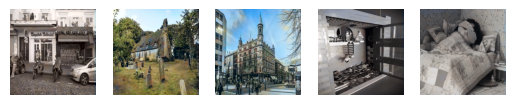


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2850.pth.
Train Epoch: 2851 [0/256 (0%)]	GanLoss: 0.318371	UNetLoss: 0.417381
Train Epoch: 2852 [0/256 (0%)]	GanLoss: 0.318093	UNetLoss: 0.402607
Train Epoch: 2853 [0/256 (0%)]	GanLoss: 0.318796	UNetLoss: 0.398786
Train Epoch: 2854 [0/256 (0%)]	GanLoss: 0.318405	UNetLoss: 0.417886
Train Epoch: 2855 [0/256 (0%)]	GanLoss: 0.318534	UNetLoss: 0.411050
Train Epoch: 2856 [0/256 (0%)]	GanLoss: 0.317989	UNetLoss: 0.414804
Train Epoch: 2857 [0/256 (0%)]	GanLoss: 0.317974	UNetLoss: 0.411052
Train Epoch: 2858 [0/256 (0%)]	GanLoss: 0.318218	UNetLoss: 0.408736
Train Epoch: 2859 [0/256 (0%)]	GanLoss: 0.318241	UNetLoss: 0.430654
Train Epoch: 2860 [0/256 (0%)]	GanLoss: 0.318134	UNetLoss: 0.424796
Training Output: 


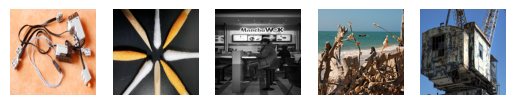

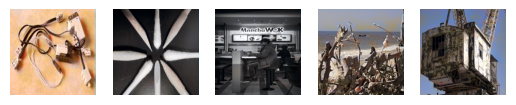

validation Output: 


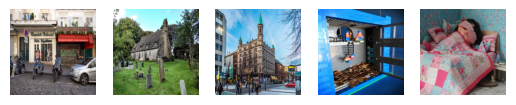

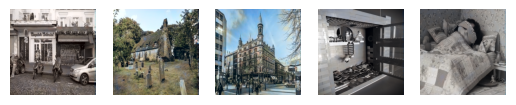


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2860.pth.
Train Epoch: 2861 [0/256 (0%)]	GanLoss: 0.318307	UNetLoss: 0.406535
Train Epoch: 2862 [0/256 (0%)]	GanLoss: 0.318420	UNetLoss: 0.417640
Train Epoch: 2863 [0/256 (0%)]	GanLoss: 0.318054	UNetLoss: 0.412468
Train Epoch: 2864 [0/256 (0%)]	GanLoss: 0.317668	UNetLoss: 0.411915
Train Epoch: 2865 [0/256 (0%)]	GanLoss: 0.317957	UNetLoss: 0.416922
Train Epoch: 2866 [0/256 (0%)]	GanLoss: 0.317756	UNetLoss: 0.402504
Train Epoch: 2867 [0/256 (0%)]	GanLoss: 0.317749	UNetLoss: 0.405984
Train Epoch: 2868 [0/256 (0%)]	GanLoss: 0.317568	UNetLoss: 0.415091
Train Epoch: 2869 [0/256 (0%)]	GanLoss: 0.317760	UNetLoss: 0.404576
Train Epoch: 2870 [0/256 (0%)]	GanLoss: 0.317637	UNetLoss: 0.401648
Training Output: 


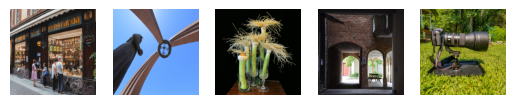

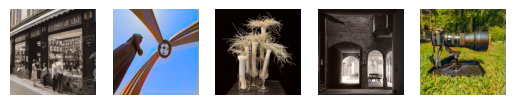

validation Output: 


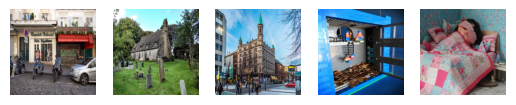

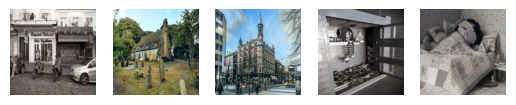


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2870.pth.
Train Epoch: 2871 [0/256 (0%)]	GanLoss: 0.317730	UNetLoss: 0.421773
Train Epoch: 2872 [0/256 (0%)]	GanLoss: 0.317385	UNetLoss: 0.399828
Train Epoch: 2873 [0/256 (0%)]	GanLoss: 0.317289	UNetLoss: 0.420226
Train Epoch: 2874 [0/256 (0%)]	GanLoss: 0.317435	UNetLoss: 0.401146
Train Epoch: 2875 [0/256 (0%)]	GanLoss: 0.317593	UNetLoss: 0.416336
Train Epoch: 2876 [0/256 (0%)]	GanLoss: 0.317282	UNetLoss: 0.417592
Train Epoch: 2877 [0/256 (0%)]	GanLoss: 0.317478	UNetLoss: 0.398535
Train Epoch: 2878 [0/256 (0%)]	GanLoss: 0.316788	UNetLoss: 0.409675
Train Epoch: 2879 [0/256 (0%)]	GanLoss: 0.317180	UNetLoss: 0.419696
Train Epoch: 2880 [0/256 (0%)]	GanLoss: 0.317328	UNetLoss: 0.399199
Training Output: 


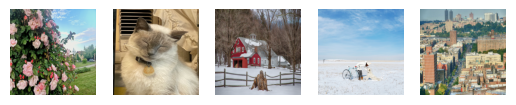

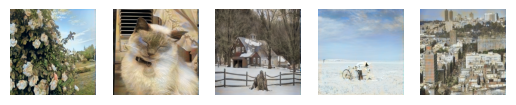

validation Output: 


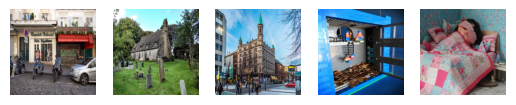

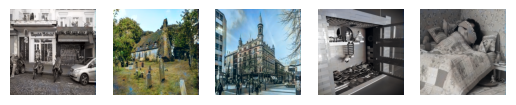


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2880.pth.
Train Epoch: 2881 [0/256 (0%)]	GanLoss: 0.317363	UNetLoss: 0.416037
Train Epoch: 2882 [0/256 (0%)]	GanLoss: 0.316940	UNetLoss: 0.416314
Train Epoch: 2883 [0/256 (0%)]	GanLoss: 0.316712	UNetLoss: 0.414556
Train Epoch: 2884 [0/256 (0%)]	GanLoss: 0.316765	UNetLoss: 0.413421
Train Epoch: 2885 [0/256 (0%)]	GanLoss: 0.317133	UNetLoss: 0.411924
Train Epoch: 2886 [0/256 (0%)]	GanLoss: 0.316773	UNetLoss: 0.402014
Train Epoch: 2887 [0/256 (0%)]	GanLoss: 0.317093	UNetLoss: 0.412622
Train Epoch: 2888 [0/256 (0%)]	GanLoss: 0.317301	UNetLoss: 0.409957
Train Epoch: 2889 [0/256 (0%)]	GanLoss: 0.317452	UNetLoss: 0.420248
Train Epoch: 2890 [0/256 (0%)]	GanLoss: 0.317026	UNetLoss: 0.407339
Training Output: 


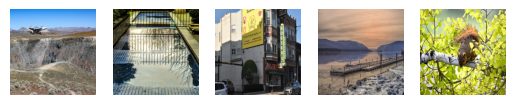

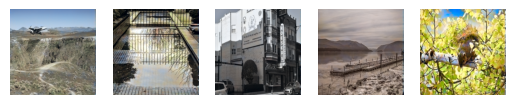

validation Output: 


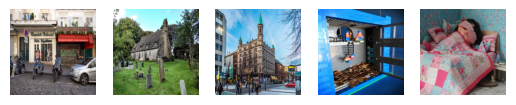

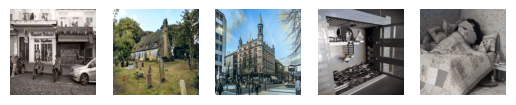


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2890.pth.
Train Epoch: 2891 [0/256 (0%)]	GanLoss: 0.316522	UNetLoss: 0.424540
Train Epoch: 2892 [0/256 (0%)]	GanLoss: 0.316700	UNetLoss: 0.435259
Train Epoch: 2893 [0/256 (0%)]	GanLoss: 0.317647	UNetLoss: 0.436665
Train Epoch: 2894 [0/256 (0%)]	GanLoss: 0.318015	UNetLoss: 0.417177
Train Epoch: 2895 [0/256 (0%)]	GanLoss: 0.317119	UNetLoss: 0.409012
Train Epoch: 2896 [0/256 (0%)]	GanLoss: 0.316997	UNetLoss: 0.406392
Train Epoch: 2897 [0/256 (0%)]	GanLoss: 0.316702	UNetLoss: 0.411465
Train Epoch: 2898 [0/256 (0%)]	GanLoss: 0.316708	UNetLoss: 0.406202
Train Epoch: 2899 [0/256 (0%)]	GanLoss: 0.316308	UNetLoss: 0.422394
Train Epoch: 2900 [0/256 (0%)]	GanLoss: 0.316034	UNetLoss: 0.414552
Training Output: 


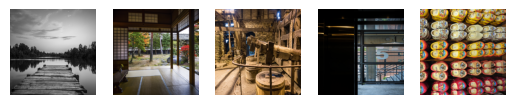

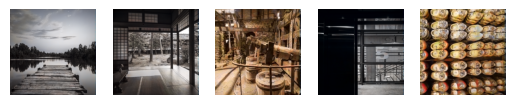

validation Output: 


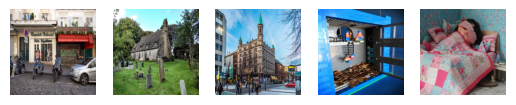

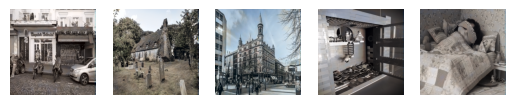


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2900.pth.
Train Epoch: 2901 [0/256 (0%)]	GanLoss: 0.316145	UNetLoss: 0.406417
Train Epoch: 2902 [0/256 (0%)]	GanLoss: 0.316361	UNetLoss: 0.430746
Train Epoch: 2903 [0/256 (0%)]	GanLoss: 0.316241	UNetLoss: 0.412467
Train Epoch: 2904 [0/256 (0%)]	GanLoss: 0.316427	UNetLoss: 0.409687
Train Epoch: 2905 [0/256 (0%)]	GanLoss: 0.316715	UNetLoss: 0.416550
Train Epoch: 2906 [0/256 (0%)]	GanLoss: 0.316265	UNetLoss: 0.417808
Train Epoch: 2907 [0/256 (0%)]	GanLoss: 0.316147	UNetLoss: 0.416310
Train Epoch: 2908 [0/256 (0%)]	GanLoss: 0.316331	UNetLoss: 0.419874
Train Epoch: 2909 [0/256 (0%)]	GanLoss: 0.315791	UNetLoss: 0.407151
Train Epoch: 2910 [0/256 (0%)]	GanLoss: 0.315959	UNetLoss: 0.413515
Training Output: 


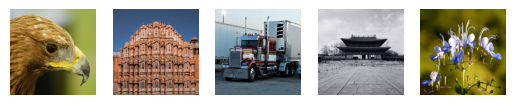

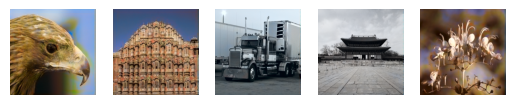

validation Output: 


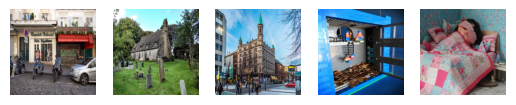

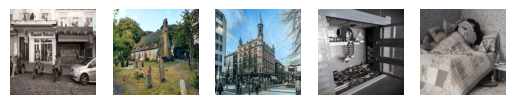


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2910.pth.
Train Epoch: 2911 [0/256 (0%)]	GanLoss: 0.316049	UNetLoss: 0.401662
Train Epoch: 2912 [0/256 (0%)]	GanLoss: 0.316329	UNetLoss: 0.407643
Train Epoch: 2913 [0/256 (0%)]	GanLoss: 0.316161	UNetLoss: 0.408422
Train Epoch: 2914 [0/256 (0%)]	GanLoss: 0.315775	UNetLoss: 0.398410
Train Epoch: 2915 [0/256 (0%)]	GanLoss: 0.316182	UNetLoss: 0.410055
Train Epoch: 2916 [0/256 (0%)]	GanLoss: 0.315604	UNetLoss: 0.407862
Train Epoch: 2917 [0/256 (0%)]	GanLoss: 0.315621	UNetLoss: 0.417176
Train Epoch: 2918 [0/256 (0%)]	GanLoss: 0.316018	UNetLoss: 0.409482
Train Epoch: 2919 [0/256 (0%)]	GanLoss: 0.315964	UNetLoss: 0.412332
Train Epoch: 2920 [0/256 (0%)]	GanLoss: 0.315748	UNetLoss: 0.405476
Training Output: 


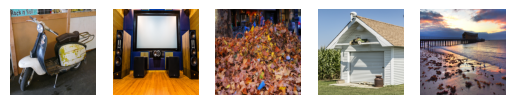

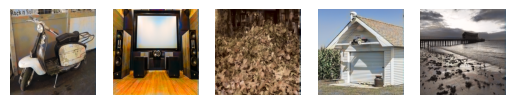

validation Output: 


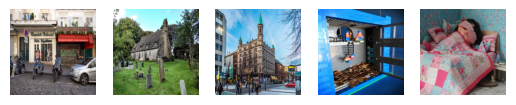

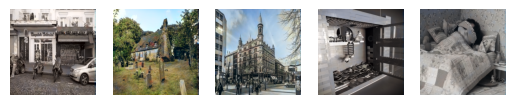


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2920.pth.
Train Epoch: 2921 [0/256 (0%)]	GanLoss: 0.316140	UNetLoss: 0.413218
Train Epoch: 2922 [0/256 (0%)]	GanLoss: 0.315939	UNetLoss: 0.420688
Train Epoch: 2923 [0/256 (0%)]	GanLoss: 0.315444	UNetLoss: 0.403766
Train Epoch: 2924 [0/256 (0%)]	GanLoss: 0.315527	UNetLoss: 0.406018
Train Epoch: 2925 [0/256 (0%)]	GanLoss: 0.315046	UNetLoss: 0.409676
Train Epoch: 2926 [0/256 (0%)]	GanLoss: 0.315676	UNetLoss: 0.423531
Train Epoch: 2927 [0/256 (0%)]	GanLoss: 0.315478	UNetLoss: 0.401595
Train Epoch: 2928 [0/256 (0%)]	GanLoss: 0.315482	UNetLoss: 0.413900
Train Epoch: 2929 [0/256 (0%)]	GanLoss: 0.315161	UNetLoss: 0.402496
Train Epoch: 2930 [0/256 (0%)]	GanLoss: 0.315068	UNetLoss: 0.408389
Training Output: 


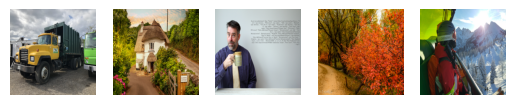

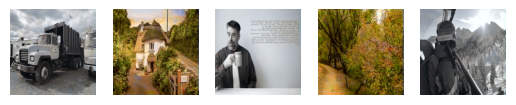

validation Output: 


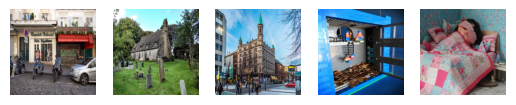

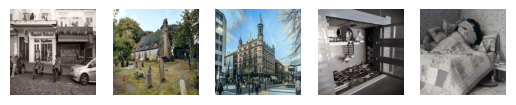


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2930.pth.
Train Epoch: 2931 [0/256 (0%)]	GanLoss: 0.315164	UNetLoss: 0.405364
Train Epoch: 2932 [0/256 (0%)]	GanLoss: 0.315274	UNetLoss: 0.405524
Train Epoch: 2933 [0/256 (0%)]	GanLoss: 0.315566	UNetLoss: 0.409236
Train Epoch: 2934 [0/256 (0%)]	GanLoss: 0.314886	UNetLoss: 0.419627
Train Epoch: 2935 [0/256 (0%)]	GanLoss: 0.314954	UNetLoss: 0.403855
Train Epoch: 2936 [0/256 (0%)]	GanLoss: 0.315242	UNetLoss: 0.397279
Train Epoch: 2937 [0/256 (0%)]	GanLoss: 0.315203	UNetLoss: 0.411657
Train Epoch: 2938 [0/256 (0%)]	GanLoss: 0.315163	UNetLoss: 0.416616
Train Epoch: 2939 [0/256 (0%)]	GanLoss: 0.315039	UNetLoss: 0.409666
Train Epoch: 2940 [0/256 (0%)]	GanLoss: 0.315022	UNetLoss: 0.404495
Training Output: 


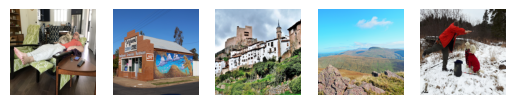

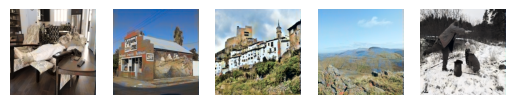

validation Output: 


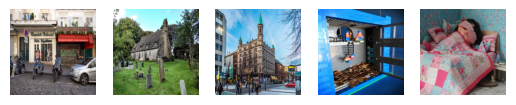

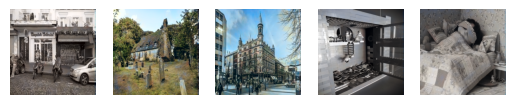


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2940.pth.
Train Epoch: 2941 [0/256 (0%)]	GanLoss: 0.314817	UNetLoss: 0.402029
Train Epoch: 2942 [0/256 (0%)]	GanLoss: 0.314669	UNetLoss: 0.404480
Train Epoch: 2943 [0/256 (0%)]	GanLoss: 0.314984	UNetLoss: 0.411557
Train Epoch: 2944 [0/256 (0%)]	GanLoss: 0.314935	UNetLoss: 0.414354
Train Epoch: 2945 [0/256 (0%)]	GanLoss: 0.314600	UNetLoss: 0.413621
Train Epoch: 2946 [0/256 (0%)]	GanLoss: 0.314684	UNetLoss: 0.405849
Train Epoch: 2947 [0/256 (0%)]	GanLoss: 0.315336	UNetLoss: 0.418808
Train Epoch: 2948 [0/256 (0%)]	GanLoss: 0.314557	UNetLoss: 0.409104
Train Epoch: 2949 [0/256 (0%)]	GanLoss: 0.314537	UNetLoss: 0.412286
Train Epoch: 2950 [0/256 (0%)]	GanLoss: 0.314436	UNetLoss: 0.418872
Training Output: 


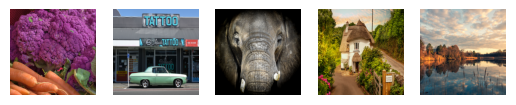

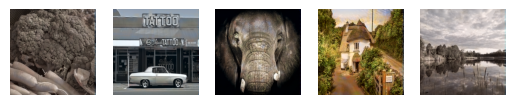

validation Output: 


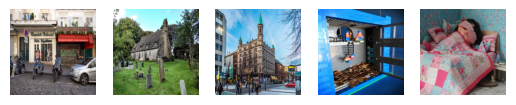

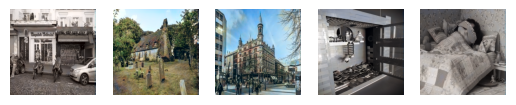


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2950.pth.
Train Epoch: 2951 [0/256 (0%)]	GanLoss: 0.314810	UNetLoss: 0.412432
Train Epoch: 2952 [0/256 (0%)]	GanLoss: 0.314640	UNetLoss: 0.415069
Train Epoch: 2953 [0/256 (0%)]	GanLoss: 0.314640	UNetLoss: 0.411489
Train Epoch: 2954 [0/256 (0%)]	GanLoss: 0.314269	UNetLoss: 0.412161
Train Epoch: 2955 [0/256 (0%)]	GanLoss: 0.314524	UNetLoss: 0.406411
Train Epoch: 2956 [0/256 (0%)]	GanLoss: 0.314306	UNetLoss: 0.407283
Train Epoch: 2957 [0/256 (0%)]	GanLoss: 0.314437	UNetLoss: 0.411719
Train Epoch: 2958 [0/256 (0%)]	GanLoss: 0.313985	UNetLoss: 0.402549
Train Epoch: 2959 [0/256 (0%)]	GanLoss: 0.314105	UNetLoss: 0.411507
Train Epoch: 2960 [0/256 (0%)]	GanLoss: 0.313883	UNetLoss: 0.407557
Training Output: 


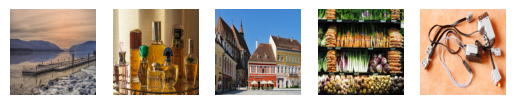

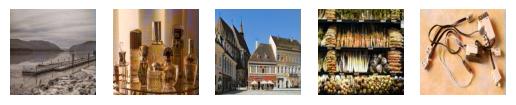

validation Output: 


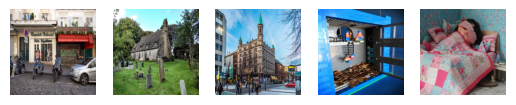

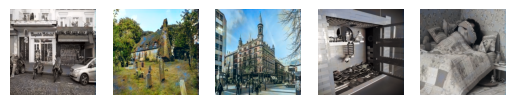


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2960.pth.
Train Epoch: 2961 [0/256 (0%)]	GanLoss: 0.314252	UNetLoss: 0.410483
Train Epoch: 2962 [0/256 (0%)]	GanLoss: 0.314437	UNetLoss: 0.402646
Train Epoch: 2963 [0/256 (0%)]	GanLoss: 0.314276	UNetLoss: 0.398053
Train Epoch: 2964 [0/256 (0%)]	GanLoss: 0.314283	UNetLoss: 0.409161
Train Epoch: 2965 [0/256 (0%)]	GanLoss: 0.313678	UNetLoss: 0.407636
Train Epoch: 2966 [0/256 (0%)]	GanLoss: 0.314152	UNetLoss: 0.416286
Train Epoch: 2967 [0/256 (0%)]	GanLoss: 0.314251	UNetLoss: 0.411351
Train Epoch: 2968 [0/256 (0%)]	GanLoss: 0.314131	UNetLoss: 0.424341
Train Epoch: 2969 [0/256 (0%)]	GanLoss: 0.313404	UNetLoss: 0.409556
Train Epoch: 2970 [0/256 (0%)]	GanLoss: 0.313922	UNetLoss: 0.404912
Training Output: 


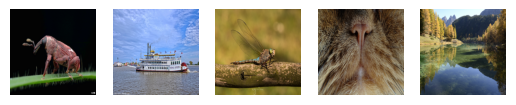

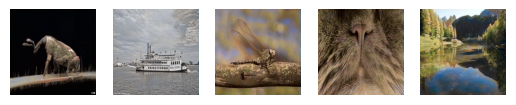

validation Output: 


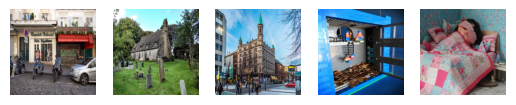

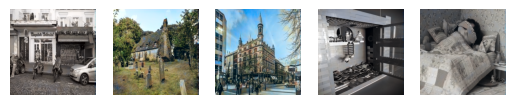


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2970.pth.
Train Epoch: 2971 [0/256 (0%)]	GanLoss: 0.313670	UNetLoss: 0.409690
Train Epoch: 2972 [0/256 (0%)]	GanLoss: 0.314046	UNetLoss: 0.408058
Train Epoch: 2973 [0/256 (0%)]	GanLoss: 0.313851	UNetLoss: 0.398586
Train Epoch: 2974 [0/256 (0%)]	GanLoss: 0.313804	UNetLoss: 0.413565
Train Epoch: 2975 [0/256 (0%)]	GanLoss: 0.313875	UNetLoss: 0.401833
Train Epoch: 2976 [0/256 (0%)]	GanLoss: 0.313702	UNetLoss: 0.399374
Train Epoch: 2977 [0/256 (0%)]	GanLoss: 0.313599	UNetLoss: 0.407102
Train Epoch: 2978 [0/256 (0%)]	GanLoss: 0.313453	UNetLoss: 0.407980
Train Epoch: 2979 [0/256 (0%)]	GanLoss: 0.313525	UNetLoss: 0.399959
Train Epoch: 2980 [0/256 (0%)]	GanLoss: 0.313192	UNetLoss: 0.421406
Training Output: 


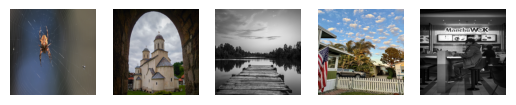

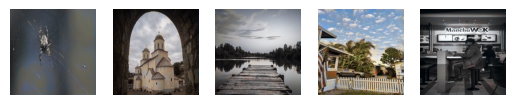

validation Output: 


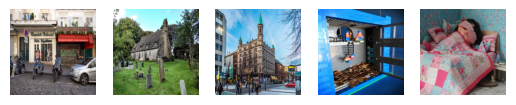

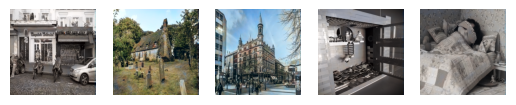


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2980.pth.
Train Epoch: 2981 [0/256 (0%)]	GanLoss: 0.313209	UNetLoss: 0.394602
Train Epoch: 2982 [0/256 (0%)]	GanLoss: 0.313482	UNetLoss: 0.394079
Train Epoch: 2983 [0/256 (0%)]	GanLoss: 0.313663	UNetLoss: 0.402264
Train Epoch: 2984 [0/256 (0%)]	GanLoss: 0.313426	UNetLoss: 0.402557
Train Epoch: 2985 [0/256 (0%)]	GanLoss: 0.313054	UNetLoss: 0.409397
Train Epoch: 2986 [0/256 (0%)]	GanLoss: 0.313239	UNetLoss: 0.414523
Train Epoch: 2987 [0/256 (0%)]	GanLoss: 0.313392	UNetLoss: 0.403697
Train Epoch: 2988 [0/256 (0%)]	GanLoss: 0.313037	UNetLoss: 0.409096
Train Epoch: 2989 [0/256 (0%)]	GanLoss: 0.312791	UNetLoss: 0.396264
Train Epoch: 2990 [0/256 (0%)]	GanLoss: 0.312986	UNetLoss: 0.397032
Training Output: 


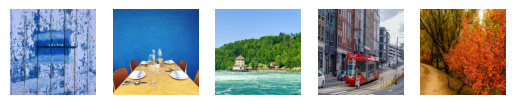

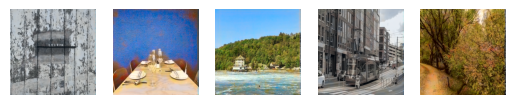

validation Output: 


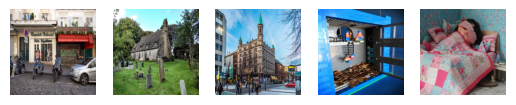

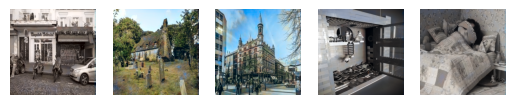


Saved model to ./GANResNetBackbone_AttnUNet/UNet_2990.pth.
Train Epoch: 2991 [0/256 (0%)]	GanLoss: 0.313509	UNetLoss: 0.407382
Train Epoch: 2992 [0/256 (0%)]	GanLoss: 0.313782	UNetLoss: 0.414889
Train Epoch: 2993 [0/256 (0%)]	GanLoss: 0.313084	UNetLoss: 0.402077
Train Epoch: 2994 [0/256 (0%)]	GanLoss: 0.312736	UNetLoss: 0.403527
Train Epoch: 2995 [0/256 (0%)]	GanLoss: 0.312905	UNetLoss: 0.393620
Train Epoch: 2996 [0/256 (0%)]	GanLoss: 0.313145	UNetLoss: 0.408023
Train Epoch: 2997 [0/256 (0%)]	GanLoss: 0.312965	UNetLoss: 0.392456
Train Epoch: 2998 [0/256 (0%)]	GanLoss: 0.312903	UNetLoss: 0.411837
Train Epoch: 2999 [0/256 (0%)]	GanLoss: 0.312958	UNetLoss: 0.395042
Train Epoch: 3000 [0/256 (0%)]	GanLoss: 0.312971	UNetLoss: 0.391490
Training Output: 


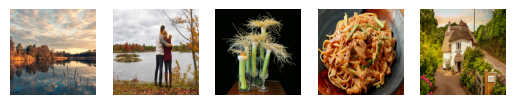

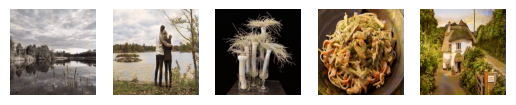

validation Output: 


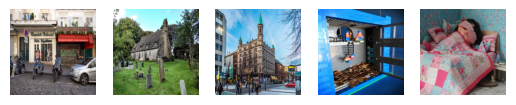

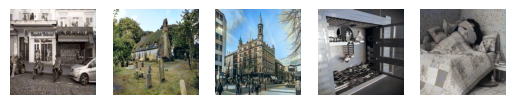


Saved model to ./GANResNetBackbone_AttnUNet/UNet_3000.pth.
Train Epoch: 3001 [0/256 (0%)]	GanLoss: 0.312517	UNetLoss: 0.408993
Train Epoch: 3002 [0/256 (0%)]	GanLoss: 0.312538	UNetLoss: 0.407333
Train Epoch: 3003 [0/256 (0%)]	GanLoss: 0.312337	UNetLoss: 0.405686


KeyboardInterrupt: 

In [13]:
train_model(5000, model)

In [ ]:
saveModel(model, './GANResNetBackbone_AttnUNet/UNet_5000.pth')

In [ ]:
torch.save(disc_loss_list, './GANResNetBackbone_AttnUNet/training_disc__loss.pt')
torch.save((val_disc_loss_list, './GANResNetBackbone_AttnUNet/validation_disc_loss.pt')
torch.save(unet_loss_list, './GANResNetBackbone_AttnUNet/training_unet_loss.pt')
torch.save(val_unet_loss_list, './GANResNetBackbone_AttnUNet/validation_unet_loss.pt')

In [16]:
model = ColorisationModel(ResidualBlock)
model.unet.to(device)
model.discriminator.to(device)
model.load_state_dict(torch.load("./GANResNetBackbone_AttnUNet/UNet_3000.pth", map_location='cuda:0'))

disc_loss_list = np.array(torch.load('./GANResNetBackbone_AttnUNet/training_disc__loss.pt')) / 4
unet_loss_list = np.array(torch.load('./GANResNetBackbone_AttnUNet/training_unet_loss.pt')) / 4

In [14]:
for (X_batch, y_batch) in train_loader:
    img_X = X_batch
    img_y = y_batch
    break

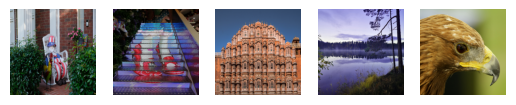

In [16]:
imshow(img_X, img_y)

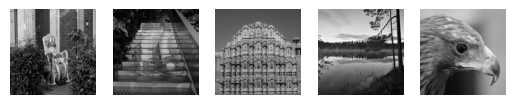

In [20]:
imshow(img_X, torch.tensor(0.0).expand_as(img_y))

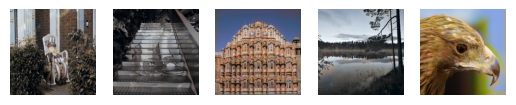

In [19]:
imshow(img_X, model.unet(img_X.to(device)).to('cpu'))        # Experiment 1 with relu and leakyrelu, and all residual blocks

In [ ]:
# Validation Output

In [26]:
i= 0
c= 1
for (X_batch, y_batch) in val_loader:
    val_img_X = X_batch
    val_img_y = y_batch
    if(i == c):
        break;
    i+= 1

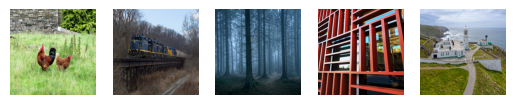

In [76]:
imshow(val_img_X, val_img_y)

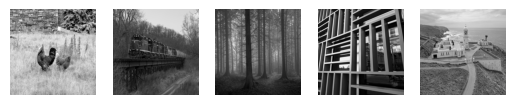

In [77]:
imshow(val_img_X, torch.tensor(0.0).expand_as(val_img_y))

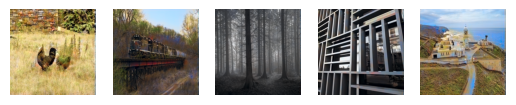

In [79]:
imshow(val_img_X, model.unet(val_img_X.to(device)).to('cpu'))

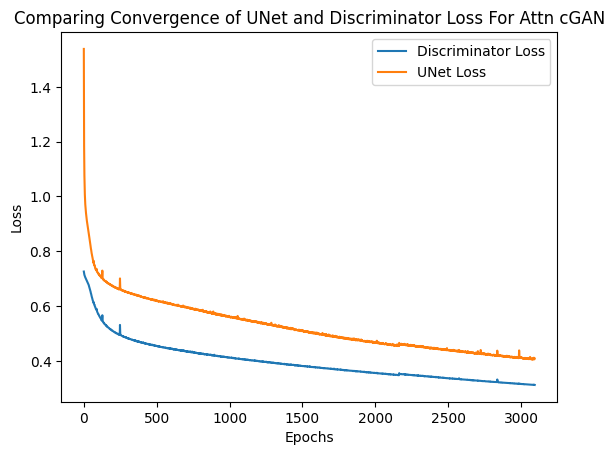

In [25]:
# Plotting of discriminator and unet loss with respect to number of epochs
plt.plot(disc_loss_list, label='Discriminator Loss')
plt.plot(unet_loss_list, label='UNet Loss')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Comparing Convergence of UNet and Discriminator Loss For Attn cGAN")
plt.show()

In [22]:
val_disc_loss, val_unet_loss = val_model(model, False)

In [23]:
print("Validation set Discriminator Loss: ", val_disc_loss)
print("Validation set UNet Loss: ", val_unet_loss)

Validation set Discriminator Loss:  0.31349533081054687
Validation set UNet Loss:  0.4671199603378773


In [24]:
print("Training set Discriminator Loss: ", disc_loss_list[-1])
print("Training set UNet Loss: ", unet_loss_list[-1])

Training set Discriminator Loss:  0.31285327672958374
Training set UNet Loss:  0.40899021178483963
